<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# DSI 37 Project 4

<a id='part_ii'></a>
[Part I](Part_1-Cleaning.ipynb#part_i) <br>
[Part III](Part_3-Modelling.ipynb#part_iii)

# Part II: EDA_and_Feature_Engineering

## Objectives

* The primary objective entails constructing a robust predictive model to facilitate informed decision-making by the city of Chicago regarding the strategic allocation of pesticide spraying for mosquito control.

* Another component of the project involves conducting a comprehensive cost-benefit analysis. This analysis encompasses projecting direct and indirect costs associated with pesticide coverage and evaluating the corresponding benefits yielded by pesticide application.

## Rationale for Synergistic Approach of EDA and Feature Engineering

* Iterative EDA and feature engineering create a feedback loop
* Insights from EDA inform feature engineering
* New features can be explored and analyzed through EDA
* Iterative process refines the data and improves the feature set
* Enhances the model's performance
* Provides a comprehensive understanding of data and variable relationships
* Results in more accurate and effective modeling

## Contents
[1. Imports (Libraries)](#imports) <br>
[2. Imports (Data)](#data_imports) <br> 
[3. EDA and Feature Engineering](#eda_feature_eng) <br>
[4. Export](#export) <br>
[5. Citations](#citations) <br>

<a id='imports'></a>

## 1. Imports (Libraries)

In [1]:
# Import basic libraries
import pandas as pd
import numpy as np

In [2]:
# Import visualisation libraries
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import json

In [3]:
# Import analysis tools
from dython.nominal import identify_nominal_columns, associations

In [4]:
# Import imblearn libraries
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek, SMOTEENN
from imblearn.under_sampling import TomekLinks
from imblearn.pipeline import Pipeline

In [5]:
# Import sklearn libraries
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, PowerTransformer

from sklearn.neighbors import BallTree
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier, GradientBoostingClassifier, RandomForestClassifier
from rgf.sklearn import RGFClassifier

from sklearn.metrics import mean_squared_error
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score

In [6]:
# Import other modelling libraries
from catboost import CatBoostClassifier
import xgboost as xgb

In [7]:
# some display adjustments to account for the fact that we have many columns
# and some columns contain many characters

np.set_printoptions(threshold=np.inf)
pd.set_option('display.max_colwidth', 400)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 800)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

<a id='data_imports'></a>

## 2. Imports (Data)

The data cleaning process is outlined in ['Part I: Cleaning'](Part_1-Cleaning.ipynb#part_i). As such we will simply proceed to importing the files.

In [8]:
# Reading the raw csv files, including the weather data file that was saved previously
train_df = pd.read_csv('../data/input/train.csv')
test_df = pd.read_csv('../data/input/test.csv')
weather_df = pd.read_csv('../data/input/cleaned_weather.csv')
spray_df = pd.read_csv('../data/input/spray.csv')

View Dataframes

In [9]:
list_df = [train_df,test_df,weather_df,spray_df]
list_df_name = ['train_df','test_df','weather_df','spray_df']

In [10]:
for i in range(len(list_df)):
    print()
    print(list_df_name[i])
    display(list_df[i].head())


train_df


,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0



test_df


,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9



weather_df


,Date,Station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,2007-05-01,1,83,50,67,14,51,56,0,2,448,1849,,0,M,0.0,0.0,29.10,29.82,1.7,27,9.2
1,2007-05-01,2,84,52,68,14,51,57,0,3,448,1849,,0,M,0.0,0.0,29.18,29.82,2.7,25,9.6
2,2007-05-02,1,59,42,51,-3,42,47,14,0,447,1850,BR,0,M,0.0,0.0,29.38,30.09,13.0,4,13.4
3,2007-05-02,2,60,43,52,-3,42,47,13,0,447,1850,BR HZ,0,M,0.0,0.0,29.44,30.08,13.3,2,13.4
4,2007-05-03,1,66,46,56,2,40,48,9,0,446,1851,,0,M,0.0,0.0,29.39,30.12,11.7,7,11.9



spray_df


,Date,Time,Latitude,Longitude
0,2011-08-29,6:56:58 PM,42.391623,-88.089163
1,2011-08-29,6:57:08 PM,42.391348,-88.089163
2,2011-08-29,6:57:18 PM,42.391022,-88.089157
3,2011-08-29,6:57:28 PM,42.390637,-88.089158
4,2011-08-29,6:57:38 PM,42.390410,-88.088858


<a id='eda_feature_eng'></a>

## 3. EDA and Feature Engineering

In this section, we process the data further to gain more insights. 

As this section is fairly extensive, it has been broken down further into 

### Contents - EDA and Feature Engineering
[A. 1st Round of Feature Engineering](#1st_Feature_Engineering)<br>
[B. Merge Dataframes](#merge)<br>
[C. 1st Round of EDA](#1st_eda)<br>
[D. 2nd Round of Feature Engineering](#2nd_Feature_Engineering)<br>

<a id='1st_Feature_Engineering'></a>

### A. 1st Round of Feature Engineering

Since mosquito behaviour and abundance is not only influenced by the current day's weather, but also by weather conditions in the preceding days, there is a need to better understand the cumulative and/or delayed effect of weather on mosquito abundance and activity. As such, we decided to create some rolling and lagged weather variables to examine it's impact on `WnvPresent`.

#### Create new columns for `Day`, `Month`, `Year`, `Week`, and `Year-Month`

In [11]:
# split 'Date' into 'Day', 'Month' and 'Year'
weather_df['Day'] = weather_df['Date'].map(lambda x: x.split('-')[2]) 
weather_df['Month'] = weather_df['Date'].map(lambda x: x.split('-')[1]) 
weather_df['Year'] = weather_df['Date'].map(lambda x: x.split('-')[0]) 

#### Convert `Date` to datetime

In [12]:
# convert 'Date' object to datetime
weather_df['Date'] = pd.to_datetime(weather_df['Date'])

In [13]:
# create new col for 'Week' and 'Year-Month'
weather_df['Week'] = weather_df['Date'].dt.isocalendar().week
weather_df['Year-Month'] = weather_df['Date'].dt.strftime('%Y %m')

In [14]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2944 entries, 0 to 2943
Data columns (total 27 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Date         2944 non-null   datetime64[ns]
 1   Station      2944 non-null   int64         
 2   Tmax         2944 non-null   int64         
 3   Tmin         2944 non-null   int64         
 4   Tavg         2944 non-null   int64         
 5   Depart       2944 non-null   int64         
 6   DewPoint     2944 non-null   int64         
 7   WetBulb      2944 non-null   int64         
 8   Heat         2944 non-null   object        
 9   Cool         2944 non-null   object        
 10  Sunrise      2944 non-null   int64         
 11  Sunset       2944 non-null   int64         
 12  CodeSum      2944 non-null   object        
 13  Depth        2944 non-null   int64         
 14  Water1       2944 non-null   object        
 15  SnowFall     2944 non-null   float64       
 16  Precip

In [15]:
# set index as 'Date'
weather_df = weather_df.set_index('Date')
# ensure data is sorted by 'Date'
weather_df = weather_df.sort_index()

#### Create rolling and lag features for `weather_df`

In [16]:
# create rolling sum  (14,21,28 days) for 'PrecipTotal',
weather_df['roll_sum_7_PrecipTotal'] = weather_df['PrecipTotal'].rolling('7D').sum()
weather_df['roll_sum_14_PrecipTotal'] = weather_df['PrecipTotal'].rolling('14D').sum()
weather_df['roll_sum_21_PrecipTotal'] = weather_df['PrecipTotal'].rolling('21D').sum()
weather_df['roll_sum_28_PrecipTotal'] = weather_df['PrecipTotal'].rolling('28D').sum()

In [17]:
# create lagged variables (14,21,28 days) for 'PrecipTotal'
weather_df['lag_7_PrecipTotal'] = weather_df['PrecipTotal'].shift(7)
weather_df['lag_14_PrecipTotal'] = weather_df['PrecipTotal'].shift(14)
weather_df['lag_21_PrecipTotal'] = weather_df['PrecipTotal'].shift(21)
weather_df['lag_28_PrecipTotal'] = weather_df['PrecipTotal'].shift(28)

In [18]:
# create rolling mean (14,21,28 days) for 'Tmax'
weather_df['roll_mean_7_Tmax'] = weather_df['Tmax'].rolling('7D').mean()
weather_df['roll_mean_14_Tmax'] = weather_df['Tmax'].rolling('14D').mean()
weather_df['roll_mean_21_Tmax'] = weather_df['Tmax'].rolling('21D').mean()
weather_df['roll_mean_28_Tmax'] = weather_df['Tmax'].rolling('28D').mean()

In [19]:
# create rolling mean (14,21,28 days) for 'Tmin'
weather_df['roll_mean_7_Tmin'] = weather_df['Tmin'].rolling('7D').mean()
weather_df['roll_mean_14_Tmin'] = weather_df['Tmin'].rolling('14D').mean()
weather_df['roll_mean_21_Tmin'] = weather_df['Tmin'].rolling('21D').mean()
weather_df['roll_mean_28_Tmin'] = weather_df['Tmin'].rolling('28D').mean()

In [20]:
# create rolling mean (14,21,28 days) for 'Tavg'
weather_df['roll_mean_7_Tavg'] = weather_df['Tavg'].rolling('7D').mean()
weather_df['roll_mean_14_Tavg'] = weather_df['Tavg'].rolling('14D').mean()
weather_df['roll_mean_21_Tavg'] = weather_df['Tavg'].rolling('21D').mean()
weather_df['roll_mean_28_Tavg'] = weather_df['Tavg'].rolling('28D').mean()

In [21]:
# reset index
weather_df = weather_df.reset_index()

In [22]:
# set 'Date' back to object
weather_df['Date'] = weather_df['Date'].dt.strftime('%Y-%m-%d')

<a id='merge'></a>

### B. Merge Dataframes

Having generated pertinent columns, including rolling and lagged weather variables, which we believe will enhance our exploratory data analysis (EDA), we shall proceed to merge `weather_df` with both `train_df` and `test_df`, consolidating the data into a unified dataframe. This integration simplifies data management and facilitates seamless referencing and analysis.

#### Find nearest weather station for each row in `train_df`

In [23]:
# create new cols with lat and lon radians
train_df['Latitude_rad'] = np.deg2rad(train_df['Latitude'])
train_df['Longitude_rad'] = np.deg2rad(train_df['Longitude'])

test_df['Latitude_rad'] = np.deg2rad(test_df['Latitude'])
test_df['Longitude_rad'] = np.deg2rad(test_df['Longitude'])

In [24]:
# to use BallTree, convert degrees to radians
# Station 1: CHICAGO O'HARE INTERNATIONAL AIRPORT Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level
lat_rad_1 = np.deg2rad(41.995)
lon_rad_1 = np.deg2rad(-87.933)
# Station 2: CHICAGO MIDWAY INTL ARPT Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level
lat_rad_2 = np.deg2rad(41.786)
lon_rad_2 = np.deg2rad(-87.752)

# Takes the first group's latitude and longitude values to construct
# the ball tree.
ball = BallTree([[lat_rad_1,lon_rad_1],[lat_rad_2,lon_rad_2]], metric='haversine')
# The amount of neighbors to return.
k = 1
# Executes a query with the second group. This will also return two arrays.
distances, indices = ball.query(train_df[["Latitude_rad", "Longitude_rad"]].values, k = k)

# if wish to convert to kilometers: distance x 6371
train_df['nearest_weather_station'] = indices
display(train_df.head())

# Executes a query with the second group. This will also return two arrays.
distances, indices = ball.query(test_df[["Latitude_rad", "Longitude_rad"]].values, k = k)

# if wish to convert to kilometers: distance x 6371
test_df['nearest_weather_station'] = indices
display(test_df.head())

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent,Latitude_rad,Longitude_rad,nearest_weather_station
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0,0.732951,-1.531863,0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0,0.732586,-1.532832,0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0,0.732586,-1.532832,0


,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,Latitude_rad,Longitude_rad,nearest_weather_station
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,0
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,0
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,0
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,0
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,0


In [25]:
# convert 1s to indicate station 2
train_df['nearest_weather_station'] = train_df['nearest_weather_station'].replace(1,2)
test_df['nearest_weather_station'] = test_df['nearest_weather_station'].replace(1,2)
# check unique values
display(train_df['nearest_weather_station'].unique())
display(test_df['nearest_weather_station'].unique())

array([0, 2])

array([0, 2])

In [26]:
# convert 0s to indicate station 1
train_df['nearest_weather_station'] = train_df['nearest_weather_station'].replace(0,1)
test_df['nearest_weather_station'] = test_df['nearest_weather_station'].replace(0,1)
# check unique values
display(train_df['nearest_weather_station'].unique())
display(test_df['nearest_weather_station'].unique())

array([1, 2])

array([1, 2])

In [27]:
train_df.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent,Latitude_rad,Longitude_rad,nearest_weather_station
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,1
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,1
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0,0.732951,-1.531863,1
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0,0.732586,-1.532832,1
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0,0.732586,-1.532832,1


In [28]:
test_df.head()

,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,Latitude_rad,Longitude_rad,nearest_weather_station
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1


#### Merge `weather_df` with `train_df` and `test_df` on `Date` and `nearest_weather_station`

In [29]:
final_train_df = train_df.merge(weather_df, how='inner', left_on=['Date','nearest_weather_station'], 
                                right_on=['Date','Station'])
final_test_df = test_df.merge(weather_df, how='inner', left_on=['Date','nearest_weather_station'], 
                                right_on=['Date','Station'])
# check if still same number of rows as train_df
display(final_train_df.info())
display(final_test_df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10506 entries, 0 to 10505
Data columns (total 61 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Date                     10506 non-null  object 
 1   Address                  10506 non-null  object 
 2   Species                  10506 non-null  object 
 3   Block                    10506 non-null  int64  
 4   Street                   10506 non-null  object 
 5   Trap                     10506 non-null  object 
 6   AddressNumberAndStreet   10506 non-null  object 
 7   Latitude                 10506 non-null  float64
 8   Longitude                10506 non-null  float64
 9   AddressAccuracy          10506 non-null  int64  
 10  NumMosquitos             10506 non-null  int64  
 11  WnvPresent               10506 non-null  int64  
 12  Latitude_rad             10506 non-null  float64
 13  Longitude_rad            10506 non-null  float64
 14  nearest_weather_statio

None

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116293 entries, 0 to 116292
Data columns (total 60 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   Id                       116293 non-null  int64  
 1   Date                     116293 non-null  object 
 2   Address                  116293 non-null  object 
 3   Species                  116293 non-null  object 
 4   Block                    116293 non-null  int64  
 5   Street                   116293 non-null  object 
 6   Trap                     116293 non-null  object 
 7   AddressNumberAndStreet   116293 non-null  object 
 8   Latitude                 116293 non-null  float64
 9   Longitude                116293 non-null  float64
 10  AddressAccuracy          116293 non-null  int64  
 11  Latitude_rad             116293 non-null  float64
 12  Longitude_rad            116293 non-null  float64
 13  nearest_weather_station  116293 non-null  int64  
 14  Stat

None

In [30]:
# drop 'Station' since it has the same info as 'nearest_weather_station'
final_train_df = final_train_df.drop('Station', axis=1)
final_test_df = final_test_df.drop('Station', axis=1)

In [31]:
# check number of unique locations
display(len(final_train_df['Address'].unique()))
display(len(final_test_df['Address'].unique()))

138

151

In [32]:
# extract list of column names
display(final_train_df.columns)
display(final_test_df.columns)

Index(['Date', 'Address', 'Species', 'Block', 'Street', 'Trap',
       'AddressNumberAndStreet', 'Latitude', 'Longitude', 'AddressAccuracy',
       'NumMosquitos', 'WnvPresent', 'Latitude_rad', 'Longitude_rad',
       'nearest_weather_station', 'Tmax', 'Tmin', 'Tavg', 'Depart', 'DewPoint',
       'WetBulb', 'Heat', 'Cool', 'Sunrise', 'Sunset', 'CodeSum', 'Depth',
       'Water1', 'SnowFall', 'PrecipTotal', 'StnPressure', 'SeaLevel',
       'ResultSpeed', 'ResultDir', 'AvgSpeed', 'Day', 'Month', 'Year', 'Week',
       'Year-Month', 'roll_sum_7_PrecipTotal', 'roll_sum_14_PrecipTotal',
       'roll_sum_21_PrecipTotal', 'roll_sum_28_PrecipTotal',
       'lag_7_PrecipTotal', 'lag_14_PrecipTotal', 'lag_21_PrecipTotal',
       'lag_28_PrecipTotal', 'roll_mean_7_Tmax', 'roll_mean_14_Tmax',
       'roll_mean_21_Tmax', 'roll_mean_28_Tmax', 'roll_mean_7_Tmin',
       'roll_mean_14_Tmin', 'roll_mean_21_Tmin', 'roll_mean_28_Tmin',
       'roll_mean_7_Tavg', 'roll_mean_14_Tavg', 'roll_mean_21_Tavg',

Index(['Id', 'Date', 'Address', 'Species', 'Block', 'Street', 'Trap',
       'AddressNumberAndStreet', 'Latitude', 'Longitude', 'AddressAccuracy',
       'Latitude_rad', 'Longitude_rad', 'nearest_weather_station', 'Tmax',
       'Tmin', 'Tavg', 'Depart', 'DewPoint', 'WetBulb', 'Heat', 'Cool',
       'Sunrise', 'Sunset', 'CodeSum', 'Depth', 'Water1', 'SnowFall',
       'PrecipTotal', 'StnPressure', 'SeaLevel', 'ResultSpeed', 'ResultDir',
       'AvgSpeed', 'Day', 'Month', 'Year', 'Week', 'Year-Month',
       'roll_sum_7_PrecipTotal', 'roll_sum_14_PrecipTotal',
       'roll_sum_21_PrecipTotal', 'roll_sum_28_PrecipTotal',
       'lag_7_PrecipTotal', 'lag_14_PrecipTotal', 'lag_21_PrecipTotal',
       'lag_28_PrecipTotal', 'roll_mean_7_Tmax', 'roll_mean_14_Tmax',
       'roll_mean_21_Tmax', 'roll_mean_28_Tmax', 'roll_mean_7_Tmin',
       'roll_mean_14_Tmin', 'roll_mean_21_Tmin', 'roll_mean_28_Tmin',
       'roll_mean_7_Tavg', 'roll_mean_14_Tavg', 'roll_mean_21_Tavg',
       'roll_mean_28_Ta

#### Convert columns to appropriate types

In [33]:
# convert 'Date' object to datetime
final_train_df['Date'] = pd.to_datetime(final_train_df['Date'])
final_test_df['Date'] = pd.to_datetime(final_test_df['Date'])

In [34]:
# convert object to int64 / float64
final_train_df = final_train_df.astype({'Tavg': 'int64','Heat':'int64','Cool':'int64','WetBulb':'int64',
                        'PrecipTotal':'float64','AvgSpeed':'float64',
                        'StnPressure': 'float64','SeaLevel':'float64',
                        'SnowFall': 'float64','Depart': 'int64','Sunrise': 'int64','Sunset': 'int64',
                       'Day': 'int64','Month': 'int64','Year': 'int64','Week':'int64'})
final_test_df = final_test_df.astype({'Tavg': 'int64','Heat':'int64','Cool':'int64','WetBulb':'int64',
                        'PrecipTotal':'float64','AvgSpeed':'float64',
                        'StnPressure': 'float64','SeaLevel':'float64',
                        'SnowFall': 'float64','Depart': 'int64','Sunrise': 'int64','Sunset': 'int64',
                       'Day': 'int64','Month': 'int64','Year': 'int64','Week':'int64'})
display(final_train_df.info())
display(final_test_df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10506 entries, 0 to 10505
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Date                     10506 non-null  datetime64[ns]
 1   Address                  10506 non-null  object        
 2   Species                  10506 non-null  object        
 3   Block                    10506 non-null  int64         
 4   Street                   10506 non-null  object        
 5   Trap                     10506 non-null  object        
 6   AddressNumberAndStreet   10506 non-null  object        
 7   Latitude                 10506 non-null  float64       
 8   Longitude                10506 non-null  float64       
 9   AddressAccuracy          10506 non-null  int64         
 10  NumMosquitos             10506 non-null  int64         
 11  WnvPresent               10506 non-null  int64         
 12  Latitude_rad             10506 n

None

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116293 entries, 0 to 116292
Data columns (total 59 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   Id                       116293 non-null  int64         
 1   Date                     116293 non-null  datetime64[ns]
 2   Address                  116293 non-null  object        
 3   Species                  116293 non-null  object        
 4   Block                    116293 non-null  int64         
 5   Street                   116293 non-null  object        
 6   Trap                     116293 non-null  object        
 7   AddressNumberAndStreet   116293 non-null  object        
 8   Latitude                 116293 non-null  float64       
 9   Longitude                116293 non-null  float64       
 10  AddressAccuracy          116293 non-null  int64         
 11  Latitude_rad             116293 non-null  float64       
 12  Longitude_rad   

None

In [35]:
display(final_train_df.columns)
display(final_test_df.columns)

Index(['Date', 'Address', 'Species', 'Block', 'Street', 'Trap',
       'AddressNumberAndStreet', 'Latitude', 'Longitude', 'AddressAccuracy',
       'NumMosquitos', 'WnvPresent', 'Latitude_rad', 'Longitude_rad',
       'nearest_weather_station', 'Tmax', 'Tmin', 'Tavg', 'Depart', 'DewPoint',
       'WetBulb', 'Heat', 'Cool', 'Sunrise', 'Sunset', 'CodeSum', 'Depth',
       'Water1', 'SnowFall', 'PrecipTotal', 'StnPressure', 'SeaLevel',
       'ResultSpeed', 'ResultDir', 'AvgSpeed', 'Day', 'Month', 'Year', 'Week',
       'Year-Month', 'roll_sum_7_PrecipTotal', 'roll_sum_14_PrecipTotal',
       'roll_sum_21_PrecipTotal', 'roll_sum_28_PrecipTotal',
       'lag_7_PrecipTotal', 'lag_14_PrecipTotal', 'lag_21_PrecipTotal',
       'lag_28_PrecipTotal', 'roll_mean_7_Tmax', 'roll_mean_14_Tmax',
       'roll_mean_21_Tmax', 'roll_mean_28_Tmax', 'roll_mean_7_Tmin',
       'roll_mean_14_Tmin', 'roll_mean_21_Tmin', 'roll_mean_28_Tmin',
       'roll_mean_7_Tavg', 'roll_mean_14_Tavg', 'roll_mean_21_Tavg',

Index(['Id', 'Date', 'Address', 'Species', 'Block', 'Street', 'Trap',
       'AddressNumberAndStreet', 'Latitude', 'Longitude', 'AddressAccuracy',
       'Latitude_rad', 'Longitude_rad', 'nearest_weather_station', 'Tmax',
       'Tmin', 'Tavg', 'Depart', 'DewPoint', 'WetBulb', 'Heat', 'Cool',
       'Sunrise', 'Sunset', 'CodeSum', 'Depth', 'Water1', 'SnowFall',
       'PrecipTotal', 'StnPressure', 'SeaLevel', 'ResultSpeed', 'ResultDir',
       'AvgSpeed', 'Day', 'Month', 'Year', 'Week', 'Year-Month',
       'roll_sum_7_PrecipTotal', 'roll_sum_14_PrecipTotal',
       'roll_sum_21_PrecipTotal', 'roll_sum_28_PrecipTotal',
       'lag_7_PrecipTotal', 'lag_14_PrecipTotal', 'lag_21_PrecipTotal',
       'lag_28_PrecipTotal', 'roll_mean_7_Tmax', 'roll_mean_14_Tmax',
       'roll_mean_21_Tmax', 'roll_mean_28_Tmax', 'roll_mean_7_Tmin',
       'roll_mean_14_Tmin', 'roll_mean_21_Tmin', 'roll_mean_28_Tmin',
       'roll_mean_7_Tavg', 'roll_mean_14_Tavg', 'roll_mean_21_Tavg',
       'roll_mean_28_Ta

In [36]:
grp_df = final_train_df.copy(deep=True)
grp_test_df = final_test_df.copy(deep=True)

<a id='1st_eda'></a>

### C. 1st Round of EDA

With the consolidated dataset we shall commence our data exploration and visualization, providing valuable insights into the provided dataset.

#### Heatmap

/Users/edenng/anaconda3/lib/python3.10/site-packages/dython/nominal.py:298: RuntimeWarning: Rounded eta = 1.0000000000000129 to 1. This is probably due to floating point precision issues.
  warnings.warn(
/Users/edenng/anaconda3/lib/python3.10/site-packages/dython/nominal.py:298: RuntimeWarning: Rounded eta = 1.0000000000000016 to 1. This is probably due to floating point precision issues.
  warnings.warn(
/Users/edenng/anaconda3/lib/python3.10/site-packages/dython/nominal.py:298: RuntimeWarning: Rounded eta = 1.0000000000000129 to 1. This is probably due to floating point precision issues.
  warnings.warn(
/Users/edenng/anaconda3/lib/python3.10/site-packages/dython/nominal.py:298: RuntimeWarning: Rounded eta = 1.0000000000000016 to 1. This is probably due to floating point precision issues.
  warnings.warn(


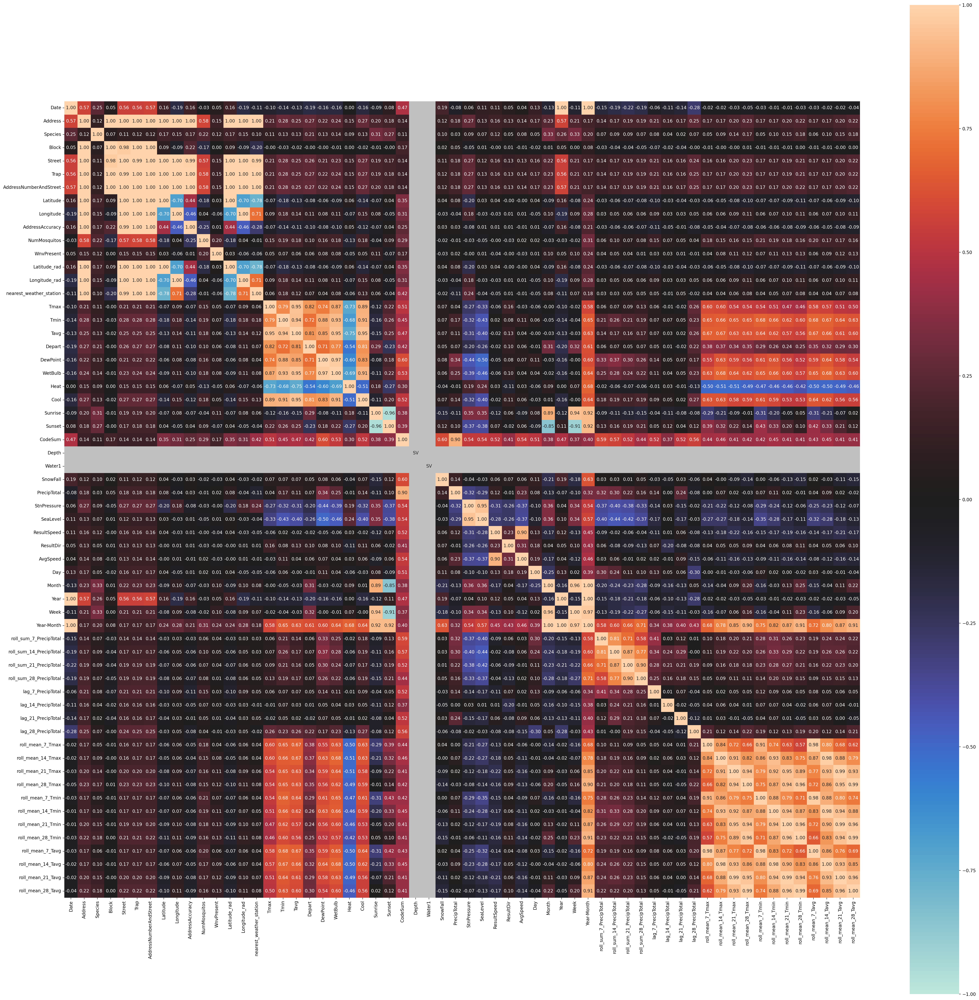

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent,Latitude_rad,Longitude_rad,nearest_weather_station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Day,Month,Year,Week,Year-Month,roll_sum_7_PrecipTotal,roll_sum_14_PrecipTotal,roll_sum_21_PrecipTotal,roll_sum_28_PrecipTotal,lag_7_PrecipTotal,lag_14_PrecipTotal,lag_21_PrecipTotal,lag_28_PrecipTotal,roll_mean_7_Tmax,roll_mean_14_Tmax,roll_mean_21_Tmax,roll_mean_28_Tmax,roll_mean_7_Tmin,roll_mean_14_Tmin,roll_mean_21_Tmin,roll_mean_28_Tmin,roll_mean_7_Tavg,roll_mean_14_Tavg,roll_mean_21_Tavg,roll_mean_28_Tavg
Date,1.000000,0.570588,0.247225,0.047408,0.556691,0.557354,0.570588,0.161692,-0.186461,0.160445,-0.030553,0.054996,0.161692,-0.186461,-0.110971,-0.103536,-0.137938,-0.127102,-0.185490,-0.160777,-0.156632,0.003934,-0.163139,-0.086982,0.078355,0.473152,0.000000,0.000000,0.185003,-0.076745,0.055725,0.109214,0.111515,0.053102,0.035731,0.128548,-0.129364,0.999327,-0.114965,0.999954,-0.151227,-0.189623,-0.219589,-0.194211,-0.064116,-0.108990,-0.135881,-0.282367,-0.023507,-0.017400,-0.028675,-0.048148,-0.031308,-0.012976,-0.012600,-0.026100,-0.030110,-0.017540,-0.022343,-0.038130
Address,0.570588,1.000000,0.116651,1.000000,0.999518,0.999904,1.000000,1.000000,1.000000,1.000000,0.578841,0.153388,1.000000,1.000000,1.000000,0.211372,0.282055,0.251218,0.269036,0.219481,0.238879,0.147740,0.274250,0.196579,0.177725,0.142018,0.000000,0.000000,0.118210,0.177962,0.268997,0.128035,0.161724,0.134192,0.137788,0.169664,0.227989,0.572033,0.211530,0.171236,0.143654,0.173218,0.192447,0.190560,0.213453,0.163620,0.165568,0.250865,0.165904,0.166442,0.201345,0.231643,0.170616,0.173710,0.195882,0.215029,0.171001,0.172034,0.199999,0.224308
Species,0.247225,0.116651,1.000000,0.072474,0.114367,0.116313,0.116651,0.166276,0.145846,0.166058,0.217697,0.121953,0.166276,0.145846,0.101455,0.112479,0.130358,0.127851,0.205146,0.133580,0.138099,0.090728,0.127493,0.313405,0.274919,0.105997,0.000000,0.000000,0.098388,0.025998,0.093509,0.072322,0.117353,0.045713,0.083102,0.050780,0.328583,0.257727,0.333648,0.196560,0.069895,0.091932,0.086854,0.072114,0.075026,0.039008,0.022320,0.071274,0.054919,0.093652,0.142657,0.171132,0.054224,0.096022,0.145897,0.175136,0.055572,0.097128,0.147046,0.175899
Block,0.047408,1.000000,0.072474,1.000000,0.975571,0.999402,1.000000,0.091110,-0.090375,0.222134,-0.172388,0.004877,0.091110,-0.090375,-0.197106,-0.000553,-0.031314,-0.015353,-0.002674,-0.004112,-0.010465,0.003976,-0.018083,-0.006206,-0.002874,0.167363,0.000000,0.000000,0.021321,0.049399,-0.050980,0.007177,-0.003398,0.008618,-0.012909,-0.020620,0.010263,0.047036,0.001587,0.084888,-0.026853,-0.043157,-0.039092,-0.052090,-0.070310,-0.016342,-0.040809,-0.002776,-0.009703,-0.001714,-0.001498,0.007453,-0.010322,-0.011252,-0.007535,0.001384,-0.010454,-0.006945,-0.004967,0.003997
Street,0.556691,0.999518,0.114367,0.975571,1.000000,0.992840,0.999518,0.997346,0.999706,0.991186,0.568115,0.149323,0.997346,0.999706,0.990451,0.208033,0.279065,0.248191,0.264056,0.214142,0.234321,0.146464,0.270133,0.192655,0.173465,0.141115,0.000000,0.000000,0.114540,0.176315,0.265170,0.123835,0.157915,0.131934,0.134574,0.163993,0.223480,0.558135,0.206779,0.168136,0.137353,0.167903,0.187423,0.185846,0.205587,0.159650,0.164201,0.243077,0.162454,0.162239,0.196743,0.225989,0.166798,0.169860,0.191752,0.210247,0.167409,0.168020,0.195669,0.219097
Trap,0.557354,0.999904,0.116313,0.999402,0.992840,1.000000,0.999904,0.999655,0.999353,1.000000,0.578744,0.153316,0.999655,0.999353,1.000000,0.208745,0.280194,0.248692,0.265440,0.217219,0.236469,0.147425,0.271054,0.194871,0.175992,0.141558,0.000000,0.000000,0.117245,0.177778,0.268439,0.126478,0.161067,0.134102,0.137348,0.168403,0.225049,0.558685,0.208780,0.168759,0.140911,0.171161,0.189207,0.188117,0.213231,0.161040,0.163897,0.246992,0.165283,0.1656

In [37]:
# construct heatmap without dummifying
complete_correlation = associations(grp_df, figsize=(40,40))
# since data is stored as something akin to dictionary, with key being ['corr'], call key
complete_corr_df = complete_correlation['corr']
# style the table, drop NA, and precision of float
complete_corr_df.dropna(axis=1, how='all').dropna(axis=0, how='all').style.background_gradient(cmap='icefire', 
                                                                                               axis=None)

#### Relationship between `WnvPresent` and `NumMosquitos`

Since mosquito count records exceeding 50 are split into separate entries, we are able to approximate the number of mosquitos caught by counting the number of entries per day per trap. As such, while the test dataset does not contain `NumMosquitos`, it is still important to analyze the relationship between `WnvPresent` and `NumMosquitos` and see if there is any insight to be had.

In [38]:
# instantiate list of years found in the training dataset
years = [2007, 2009, 2011, 2013]

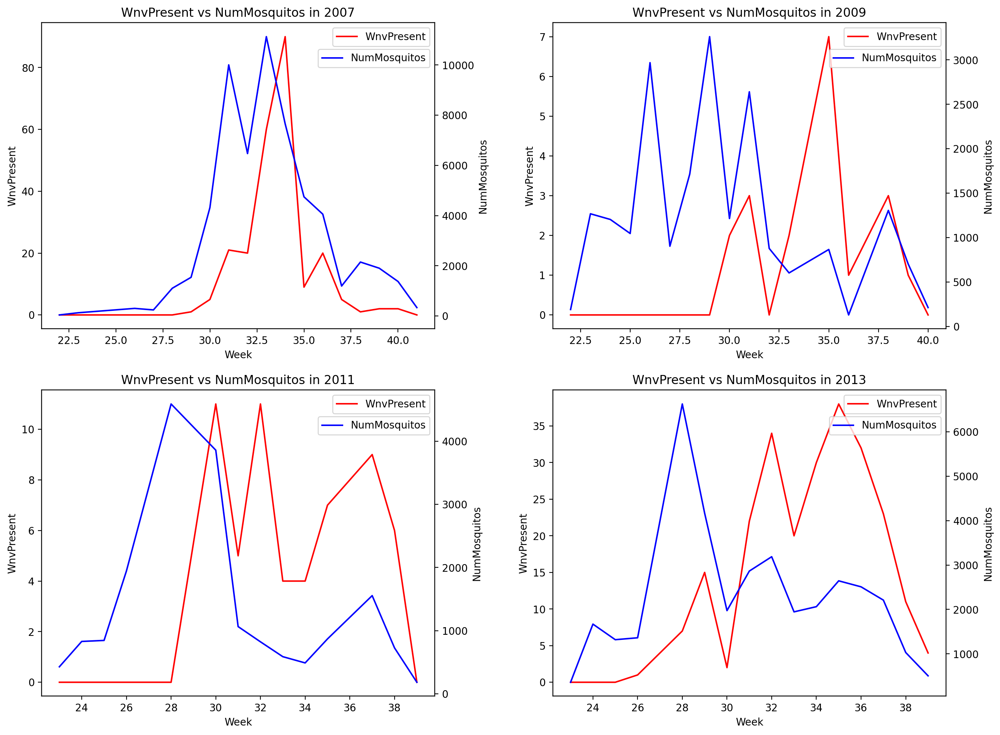

In [39]:
fig, axes = plt.subplots(2,2,figsize=(16,12))
plt.subplots_adjust(wspace=0.3)
axes = axes.flatten()

for index, year in enumerate(years):
    wnv_df = grp_df[grp_df['Year']==year].groupby(['Week']).sum(numeric_only=True)[['WnvPresent']].reset_index(col_level=1)
    n_mos_df = grp_df[grp_df['Year']==year].groupby(['Week']).sum(numeric_only=True)[['NumMosquitos']].reset_index(col_level=1)
    
    sns.lineplot(data=wnv_df,x='Week',y='WnvPresent',
                 ax=axes[index],color='red').set(title='WnvPresent vs NumMosquitos in ' + str(year))
    
    ax2 = axes[index].twinx()
    sns.lineplot(data=n_mos_df,x='Week',y='NumMosquitos',
                 ax=ax2,color='blue')
    
    axes[index].legend(['WnvPresent'],bbox_to_anchor=(1,1))
    ax2.legend(['NumMosquitos'],bbox_to_anchor=(1,0.93))

Despite the notable correlation between the two variables, a careful examination of the plots indicates a slight time delay between `WnvPresent` and `NumMosquitos`, with a slight lag in `WnvPresent` when compared to `NumMosquitos`. Thus, we are likely to consider creating a feature named `num_trap`, to capture the count of entries per day per trap to predict for `WnvPresent`. Moreover, the inclusion of variables representing the rolling sum of `num_trap` would be highly beneficial for the analysis, as the mosquito population is likely influenced by the cumulative values of preceding days.

#### Relationship between `Species` and `WnvPresent`

NumMosquitos         Percentage_of_overall  \
WnvPresent                        0       1                         
Species                                                             
CULEX ERRATICUS                 7.0     NaN                   NaN   
CULEX PIPIENS               37942.0  6729.0              4.983005   
CULEX PIPIENS/RESTUANS      59145.0  7123.0              5.274772   
CULEX RESTUANS              22764.0   667.0              0.493931   
CULEX SALINARIUS              145.0     NaN                   NaN   
CULEX TARSALIS                  7.0     NaN                   NaN   
CULEX TERRITANS               510.0     NaN                   NaN   

                       Percentage_of_virus  
WnvPresent                                  
Species                                     
CULEX ERRATICUS                        NaN  
CULEX PIPIENS                    46.346167  
CULEX PIPIENS/RESTUANS           49.059853  
CULEX RESTUANS                    4.593980  
CULEX SALINARIUS                       NaN  
CULEX TARSALIS                         NaN  
CULEX TERRITANS                        NaN

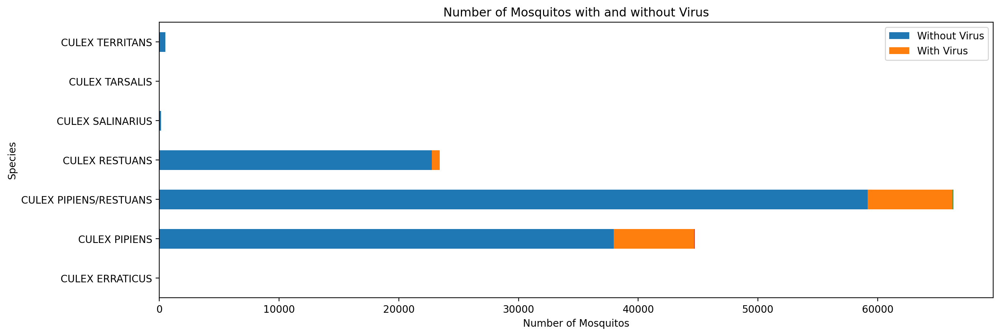

In [40]:
# among the species, Culex pipiens and Culex Restuans are the WNV vectors. We can thus regroup the species as WNV carrier (1) and non-WNV carrier (0). 

# print('Culex species that carry WNV: ', grp_df.query('WnvPresent==1').Species.unique())
# fig, ax = plt.subplots(figsize=(12,5))
# _ = sns.countplot(x='Species', data=grp_df,hue='WnvPresent')
# plt.setp(ax.get_xticklabels(), rotation=30, fontsize=8, horizontalalignment='right')

species_with_virus = grp_df.pivot_table(values=['NumMosquitos'], index='Species',
                                       columns='WnvPresent', aggfunc='sum')

# Calculate the overall total number of mosquitos across all species
overall_total = species_with_virus['NumMosquitos'].sum().sum()

# Calculate the overall total number of mosquitos with virus across all species
overall_virus = species_with_virus['NumMosquitos',1].sum()

# Create a new column for the percentage
species_with_virus['Percentage_of_overall'] = species_with_virus[('NumMosquitos', 1)] / overall_total * 100
species_with_virus['Percentage_of_virus'] = species_with_virus[('NumMosquitos', 1)] / overall_virus * 100


display(species_with_virus)

species_with_virus.plot(kind='barh', stacked=True, figsize=(15,5))
plt.title("Number of Mosquitos with and without Virus")
plt.xlabel("Number of Mosquitos")
plt.legend(labels=["Without Virus", "With Virus"]);

<Axes: xlabel='WnvPresent', ylabel='Species'>

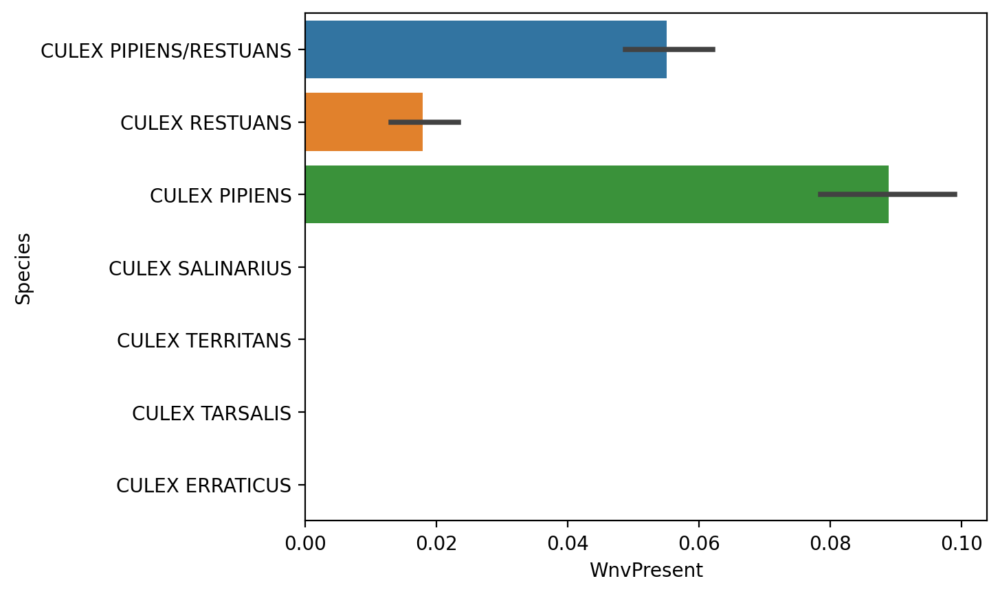

In [41]:
# check presence of different 'Species' for 'WnvPresent'
sns.barplot(data=grp_df,x='WnvPresent',y='Species')

In [42]:
grp_df[['WnvPresent', 'Species']].groupby('Species').sum()

,WnvPresent
Species,
CULEX ERRATICUS,0
CULEX PIPIENS,240
CULEX PIPIENS/RESTUANS,262
CULEX RESTUANS,49
CULEX SALINARIUS,0
CULEX TARSALIS,0
CULEX TERRITANS,0


Based on the aforementioned observations, it can be inferred that the mosquito species 'PIPIENS' and 'RESTUANS' are carriers of the West Nile virus, while the remaining species caught do not pose a risk. Consequently, considering the conversion of the `Species` column to an ordinal representation would be a prudent step.

#### Relationship between `Latitude`, `Longitude` and `WnvPresent`

In [43]:
# change 'Year-Month' type, from object to period[M]
grp_df['Year-Month'] = pd.to_datetime(grp_df['Year-Month'], format='%Y %m').dt.to_period('M')

In [44]:
# Calculate total 'NumMosquitos'
total_mosquito = grp_df.groupby(['Address','Year-Month'], as_index=False)['NumMosquitos'].sum()
total_mosquito.sort_values(by='Year-Month', inplace=True)

# Calculate median 'latitude' and 'longitude' for each address
areas = grp_df.groupby('Address', as_index=False)[['Latitude', 'Longitude']].median()

# Calculate total number of 'WnvPresent'
virus = grp_df.groupby('Address', as_index=False)['WnvPresent'].sum()

# merge datasets together
mos_data = pd.merge(total_mosquito, areas, on='Address')
mos_data = pd.merge(mos_data, virus, on='Address')

# since we no longer need 'Address', drop col
mos_data.drop('Address', axis = 1, inplace = True)

# sort by 'Year-Month'
mos_data.sort_values(by='Year-Month', inplace=True)
mos_data.head()

,Year-Month,NumMosquitos,Latitude,Longitude,WnvPresent
0,2007-05,2,41.688324,-87.676709,8
97,2007-05,6,41.731922,-87.677512,6
103,2007-05,1,42.017430,-87.687769,0
115,2007-05,1,41.994991,-87.769279,0
121,2007-05,1,41.907645,-87.760886,0


In [45]:
# Load the Chicago boundaries from GeoJSON file
with open('../data/input/communityareas.geojson') as f:
    chicago_geojson = json.load(f)

# Set the Mapbox access token
px.set_mapbox_access_token('pk.eyJ1IjoiZ2l0aHViYmVyc3QiLCJhIjoiY2xqb3RtcjlwMWp4aDNscWNjdHZuNmU1ayJ9.BizJFoOXaa2H5jsYDkFeSg')


# Create a scatter mapbox
fig = px.scatter_mapbox(mos_data, lat='Latitude', lon='Longitude',
                        color='NumMosquitos', size='WnvPresent',
                        color_continuous_scale=px.colors.sequential.Jet,
                        hover_data=['NumMosquitos', 'WnvPresent'], zoom=9, animation_frame='Year-Month')


# Create a layer for the community area boundaries
layer_chicago = dict(
    sourcetype = 'geojson',
    source = chicago_geojson,
    type='fill',
    color='hsla(0, 100%, 90%, 0.2)',  
    below='traces',
    )

# Add the community area boundaries layer to the scatter map
fig.update_layout(mapbox_layers=[layer_chicago])

# Update the layout
fig.update_layout(title_text='WnvPresent vs NumMosquitos in Chicago<br>\
Bubble size corresponds to number of WnvPresent',
                  autosize=False,
                  width=600,
                  height=600,
                  )


# Display the figure
fig.show()

Based on the visualization of the bubble map presented above, notable concentration patterns emerge in certain areas, indicating consistent high counts of mosquitos and occurrences of West Nile virus. Consequently, it is advisable to incorporate the spatial aspect by performing feature engineering to derive a new variable that maps the location data into an ordinal representation.

#### Relationship between `Month` and `WnvPresent`

In [46]:
grp_df.groupby(['Year','Month']).sum(numeric_only=True).reset_index(col_level=1)[['Year','Month','WnvPresent']]

,Year,Month,WnvPresent
0,2007,5,0
1,2007,6,0
2,2007,7,6
3,2007,8,200
4,2007,9,28
5,2007,10,2
6,2009,5,0
7,2009,6,0
8,2009,7,5
9,2009,8,9


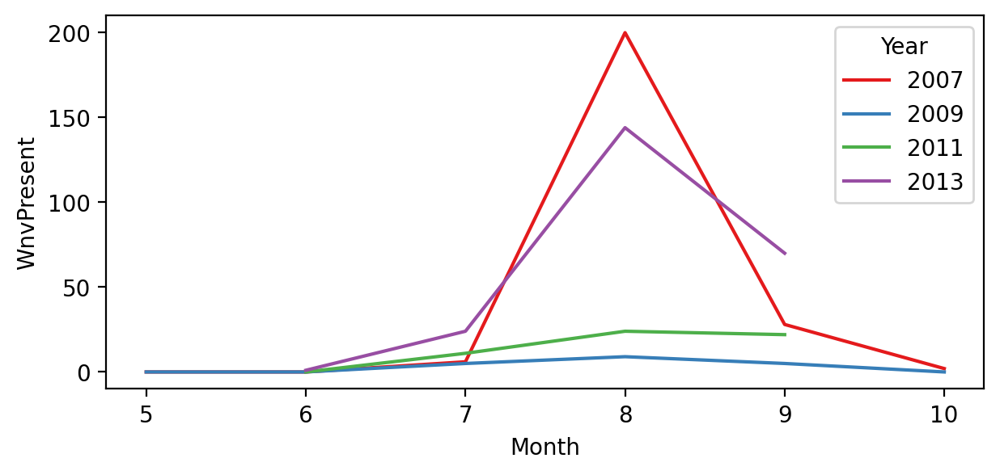

In [47]:
df = grp_df.groupby(['Year','Month']).sum(numeric_only=True).reset_index(col_level=1)[['Year','Month','WnvPresent']]
plt.subplots(figsize=(7,3))
sns.lineplot(data=df,
             x='Month', y='WnvPresent', hue='Year', errorbar=None, palette = 'Set1')
plt.ylabel("WnvPresent")
plt.show()

It can be observed that `WnvPresent` consistently starts slowly rising from June to July and peaks sharply in August. This pattern is highly likely to be influenced by specific weather conditions, which will be further examined in the subsequent analysis. 

#### Relationship between temperature, humidity and `WnvPresent`

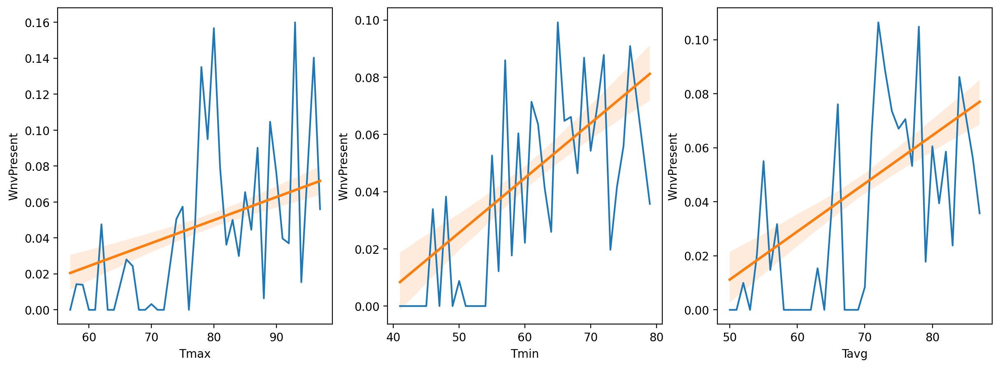

In [48]:
# Correlation of temperatures with number of mosquitoes / wnv
temperatures = ['Tmax', 'Tmin', 'Tavg']

plt.figure(figsize=(25,5))
for i, col in enumerate(temperatures):
    ax = plt.subplot(1, 5, i+1)
    sns.lineplot(data=grp_df, x=col, y='WnvPresent', errorbar=None)
    sns.regplot(data=grp_df, x=col, y='WnvPresent', scatter=False)

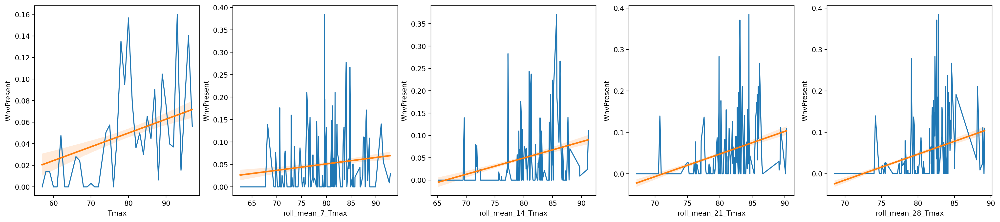

In [49]:
# Correlation of temperatures with number of mosquitoes / wnv
temperatures = ['Tmax','roll_mean_7_Tmax','roll_mean_14_Tmax','roll_mean_21_Tmax','roll_mean_28_Tmax']

plt.figure(figsize=(25,5))
for i, col in enumerate(temperatures):
    ax = plt.subplot(1, 5, i+1)
    sns.lineplot(data=grp_df, x=col, y='WnvPresent', errorbar=None)
    sns.regplot(data=grp_df, x=col, y='WnvPresent', scatter=False)

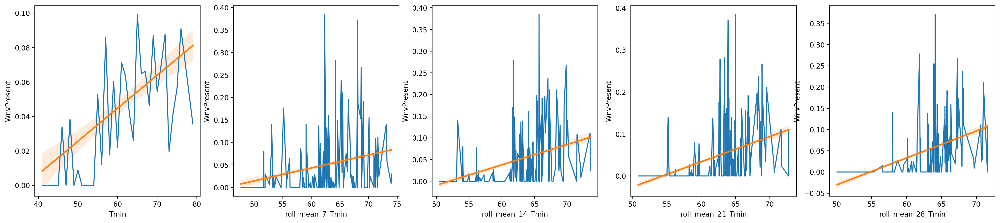

In [50]:
# Correlation of temperatures with number of mosquitoes / wnv
temperatures = ['Tmin','roll_mean_7_Tmin','roll_mean_14_Tmin','roll_mean_21_Tmin','roll_mean_28_Tmin']

plt.figure(figsize=(25,5))
for i, col in enumerate(temperatures):
    ax = plt.subplot(1, 5, i+1)
    sns.lineplot(data=grp_df, x=col, y='WnvPresent', errorbar=None)
    sns.regplot(data=grp_df, x=col, y='WnvPresent', scatter=False)

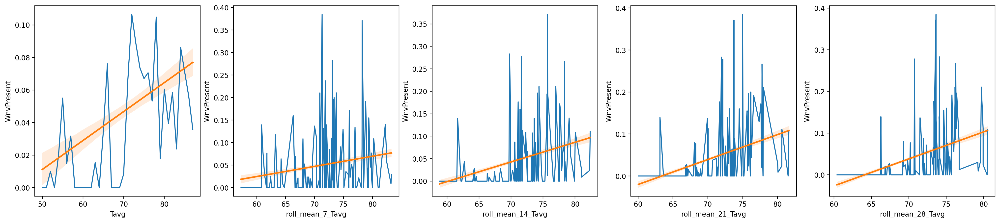

In [51]:
# Correlation of temperatures with number of mosquitoes / wnv
temperatures = ['Tavg','roll_mean_7_Tavg','roll_mean_14_Tavg','roll_mean_21_Tavg','roll_mean_28_Tavg']

plt.figure(figsize=(25,5))
for i, col in enumerate(temperatures):
    ax = plt.subplot(1, 5, i+1)
    sns.lineplot(data=grp_df, x=col, y='WnvPresent', errorbar=None)
    sns.regplot(data=grp_df, x=col, y='WnvPresent', scatter=False)

A consistent positive correlation is observed between temperature, humidity and `WnvPresent`, indicating a higher prevalence of `WnvPresent` during periods of increased temperature. This is consistent with existing literature. According to Lebl et al. (2013) the observed relationship can be attributed to the temperature-dependent development rates of mosquito life stages, including eggs, larvae, pupae, and adult survival rates. Similarly, according to Drakou et al. (2020), Studies have indicated that high humidity contributes to increased egg production, larval indices, mosquito activity, and overall influences their behavior. Furthermore, research has indicated that an optimal range of humidity, typically between 44% and 69%, stimulates mosquito flight activity, with the most suitable conditions observed at around 65%.

Nevertheless, it is important to note that the rate of increase in `WnvPresent` is not as pronounced in relation to `Tmax` (maximum temperature).

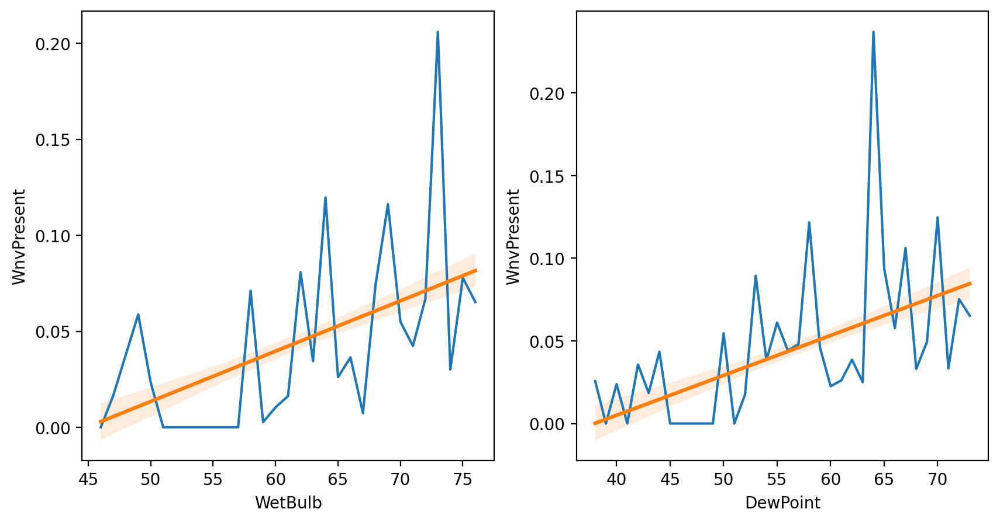

In [52]:
# Correlation of temperatures with number of mosquitoes / wnv
temperatures = ['WetBulb', 'DewPoint']

plt.figure(figsize=(10,5))
for i, col in enumerate(temperatures):
    ax = plt.subplot(1, 2, i+1)
    sns.lineplot(data=grp_df, x=col, y='WnvPresent', errorbar=None)
    sns.regplot(data=grp_df, x=col, y='WnvPresent', scatter=False)

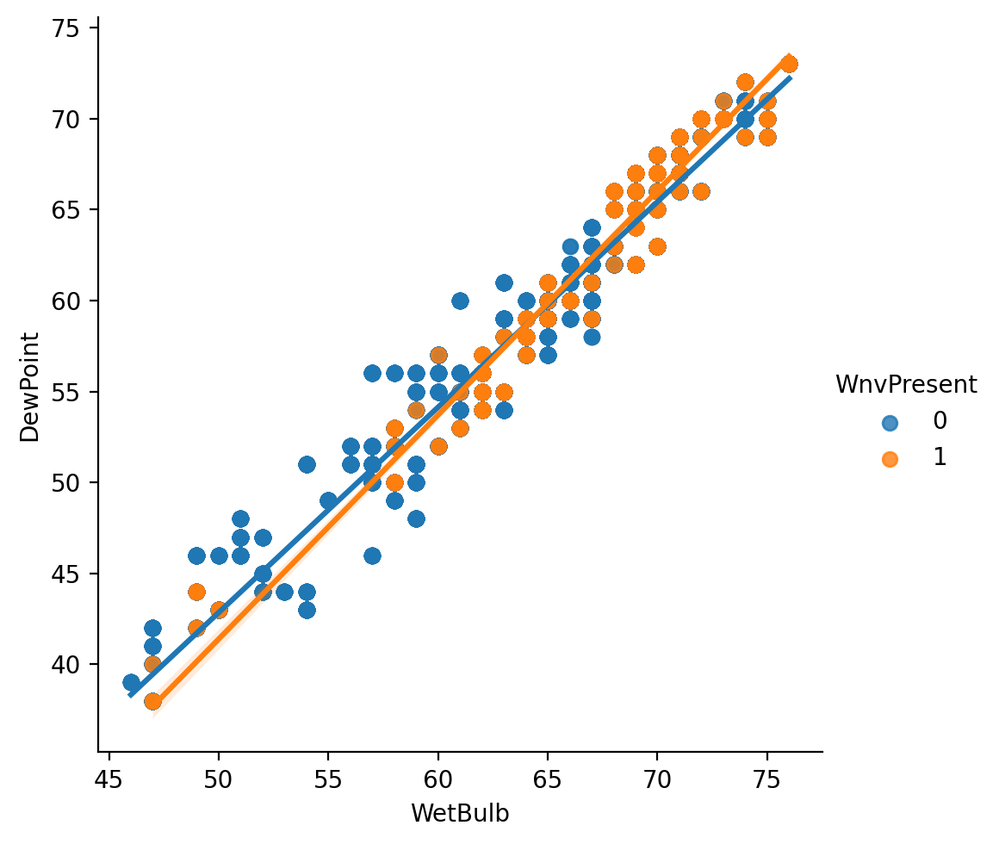

In [53]:
sns.lmplot(data=grp_df,x='WetBulb',y='DewPoint',hue='WnvPresent')

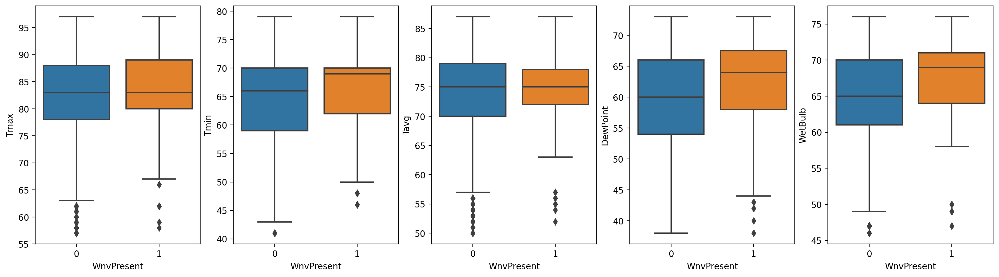

In [54]:
# Correlation of temperatures with number of mosquitoes / wnv
temperatures = ['Tmax', 'Tmin', 'Tavg', 'DewPoint', 'WetBulb']

plt.figure(figsize=(20,5))
for i, col in enumerate(temperatures):
    ax = plt.subplot(1, 5, i+1)
    sns.boxplot(data=grp_df, x='WnvPresent', y=col)

From the boxplots above, we can tell that higher temperatures are associated with the transmission of WNV.
- The lower end of the temperature range for records of positive WNV is about 10 degrees higher than that of the lower range for records of negative WNV.
- The median dewpoint, wetbulb and minimum temperature is higher in WNV positive records compared to that of WNV negative records.

#### Relationship between `Heat`, `Cool`, `NumMosquitos` and `WnvPresent`

**In the heating column, the values indicate the number of degree days below a base temperature of 65 degrees Fahrenheit.** It represents the cumulative amount of heating needed in a specific location during a particular period, typically starting in July. Higher values in the heating column indicate colder temperatures and a higher demand for heating.

Similarly, **in the cooling column, the values indicate the number of degree days above a base temperature of 65 degrees Fahrenheit.** It represents the cumulative amount of cooling needed in a specific location during a particular period, typically starting in January. Higher values in the cooling column indicate hotter temperatures and a higher demand for cooling.

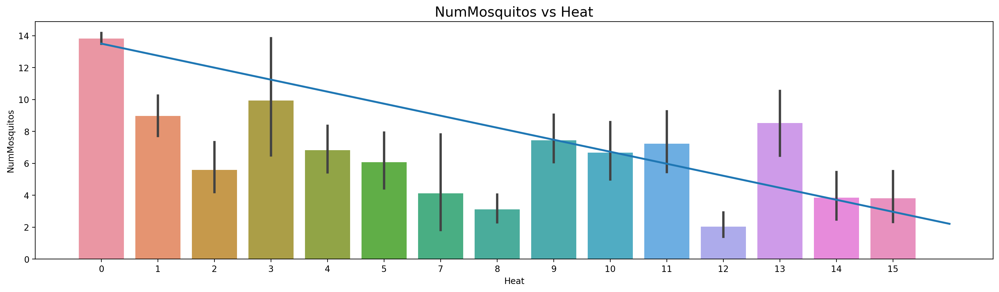

In [55]:
# Heat
plt.figure(figsize=(20,5))
plt.title('NumMosquitos vs Heat', fontsize=16)
sns.barplot(data=grp_df, x='Heat', y='NumMosquitos')
sns.regplot(data=grp_df, x='Heat', y='NumMosquitos', ci=None, scatter=False)
plt.show()

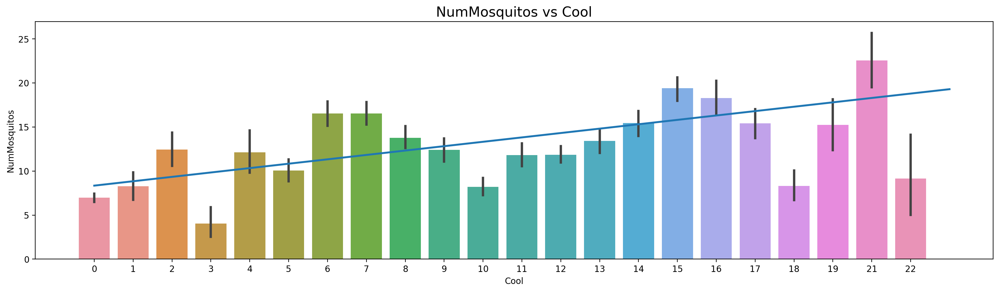

In [56]:
# Cool
plt.figure(figsize=(20,5))
plt.title('NumMosquitos vs Cool', fontsize=16)
sns.barplot(data=grp_df, x='Cool', y='NumMosquitos')
sns.regplot(data=grp_df, x='Cool', y='NumMosquitos', ci=None, scatter=False)
plt.show()

The general trend indicates that as temperatures rise, there is an increase in the number of mosquitoes, aligning with the previously observed patterns.

<Axes: xlabel='Heat', ylabel='WnvPresent'>

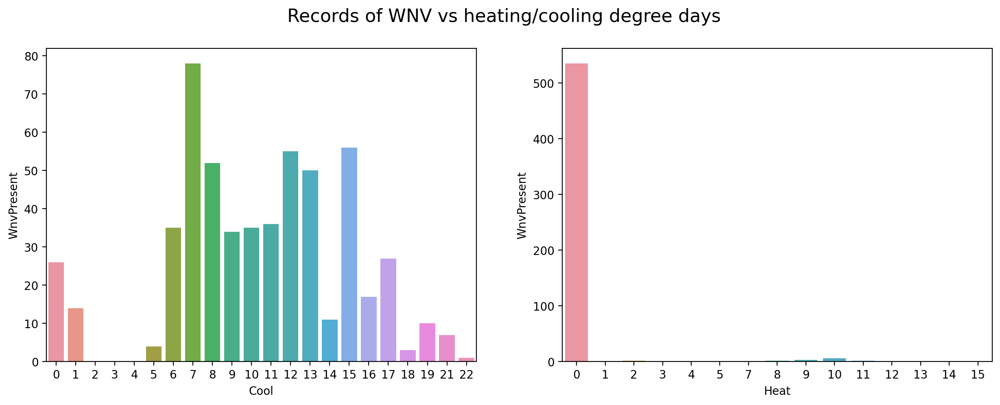

In [57]:
cool = grp_df.groupby('Cool')['WnvPresent'].sum().to_frame()
heat = grp_df.groupby('Heat')['WnvPresent'].sum().to_frame()

plt.figure(figsize=(15,5))
plt.suptitle("Records of WNV vs heating/cooling degree days", fontsize=16)
ax = plt.subplot(1, 2, 1)
sns.barplot(data=cool, y='WnvPresent', x=cool.index)

ax = plt.subplot(1, 2, 2)
sns.barplot(data=heat, y='WnvPresent', x=heat.index)

There are very few `WnvPresent` detected at temperatures below 65 degrees Farenheit. The most common temperatures are between 6 to 15 degrees above 65 degrees (i.e. 71 to 80 degrees), which is close to what we expected at 75 to 77 degrees Farenheit.

#### Relationship between `Depart` and `WnvPresent`

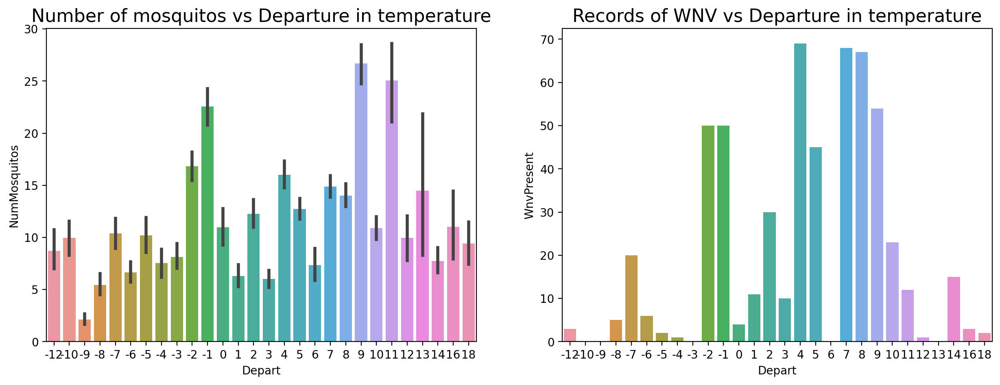

In [58]:
# Depart
plt.subplots(1,2, figsize=(15,5))

plt.subplot(1,2,1)
plt.title('Number of mosquitos vs Departure in temperature', fontsize=16)
sns.barplot(data=grp_df, x='Depart', y='NumMosquitos')

plt.subplot(1,2,2)
depart = grp_df.groupby('Depart')['WnvPresent'].sum().to_frame()
plt.title("Records of WNV vs Departure in temperature", fontsize=16)
sns.barplot(data=depart, y='WnvPresent', x=depart.index)

plt.show()

Temperature departure from the normal indicates if the dekadal (10-day) average temperatures were above or below the 30-year normal. It is calculated for each grid cell by subtracting the average air temperature estimated by AFWA from the 30-year normal (from 1961-1990).
<img src="../images/depart image.png" style=' margin: 20px; width: 410px'>

https://www.currentresults.com/Weather/Illinois/Places/chicago-temperatures-by-month-average.php

#### Relationship between `PrecipTotal` and `WnvPresent`

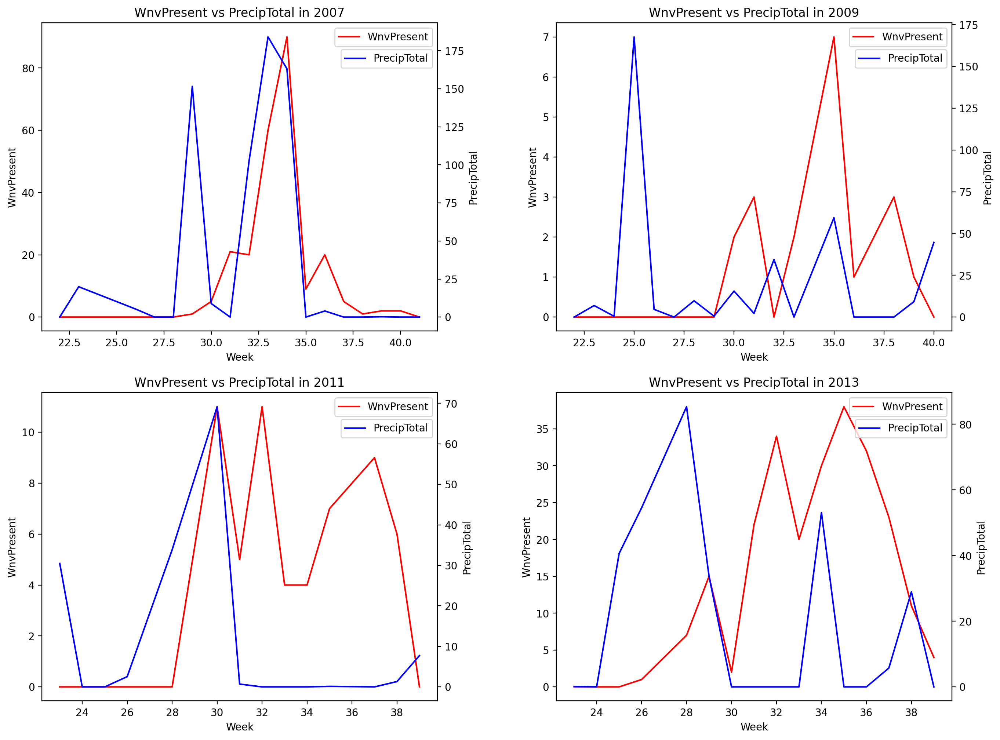

In [59]:
fig, axes = plt.subplots(2,2,figsize=(16,12))
plt.subplots_adjust(wspace=0.3)
axes = axes.flatten()

variable = 'PrecipTotal'

for index, year in enumerate(years):
    wnv_df = grp_df[grp_df['Year']==year].groupby(['Week']).sum(numeric_only=True)[['WnvPresent']].reset_index(col_level=1)
    n_mos_df = grp_df[grp_df['Year']==year].groupby(['Week']).sum(numeric_only=True)[[variable]].reset_index(col_level=1)
    
    sns.lineplot(data=wnv_df,x='Week',y='WnvPresent',
                 ax=axes[index],color='red').set(title='WnvPresent vs ' + str(variable) + ' in ' + str(year))
    
    ax2 = axes[index].twinx()
    sns.lineplot(data=n_mos_df,x='Week',y=variable,
                 ax=ax2,color='blue')
    
    axes[index].legend(['WnvPresent'],bbox_to_anchor=(1,1))
    ax2.legend([variable],bbox_to_anchor=(1,0.93))

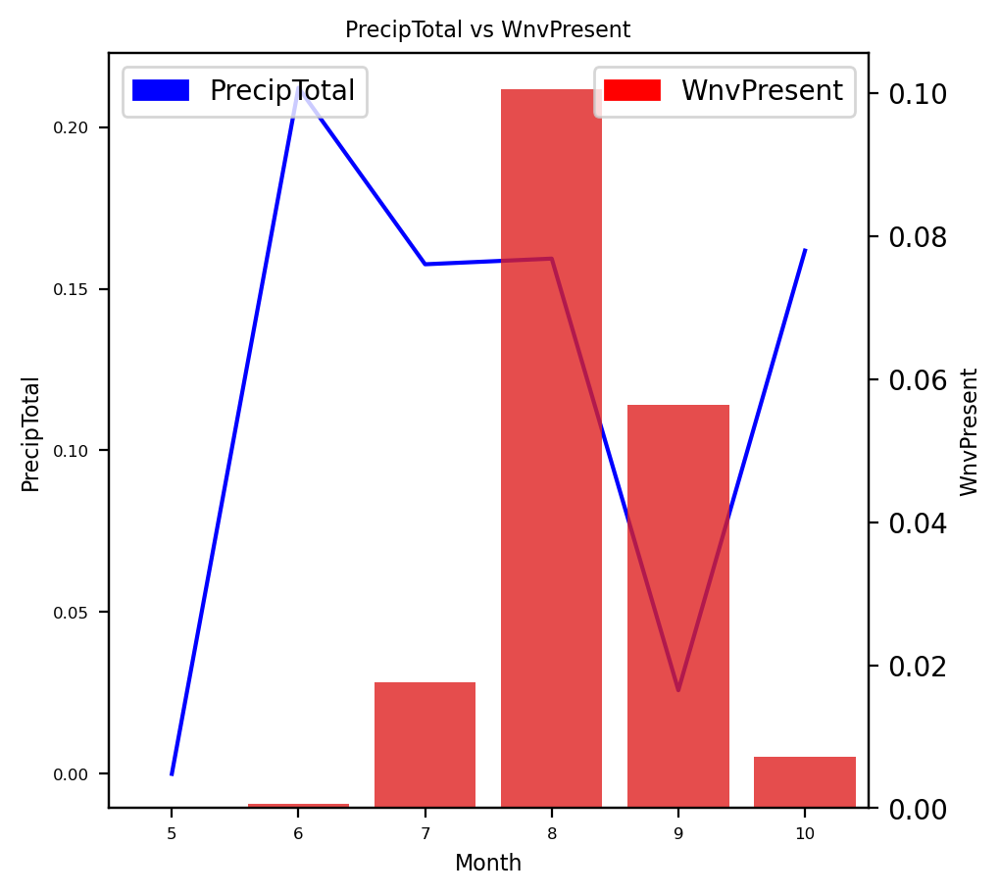

In [60]:
variable = 'PrecipTotal'
variable_WnvP_df = grp_df[['Month',variable,'WnvPresent']].groupby('Month').mean()
variable_WnvP_df = variable_WnvP_df.reset_index(col_level=1)
variable_WnvP_df = variable_WnvP_df.astype({'Month': 'string'})

fig, ax1 = plt.subplots(figsize=(5,5))
sns.lineplot(data=variable_WnvP_df,x='Month',y=variable,ax=ax1,
             color='blue',sort=False).set(ylabel=variable)
ax1_patch = mpatches.Patch(color='blue', label=variable)
ax1.legend(handles=[ax1_patch], loc="upper left")

ax2 = ax1.twinx()
sns.barplot(data=variable_WnvP_df,x='Month',y='WnvPresent',color='red',ax=ax2, 
            alpha=0.8).set(ylabel='WnvPresent')
ax2.grid(False)
ax2_patch = mpatches.Patch(color='red', label='WnvPresent')
ax2.legend(handles=[ax2_patch], loc="upper right")

fontsize=8
labelsize=6
ax1.set_title(str(variable) + ' vs WnvPresent', fontsize=fontsize)
ax1.set_ylabel(str(variable),fontsize=fontsize)
ax2.set_ylabel('WnvPresent',fontsize=fontsize)
ax1.set_xlabel('Month',fontsize=fontsize)
ax1.tick_params(labelsize=labelsize)

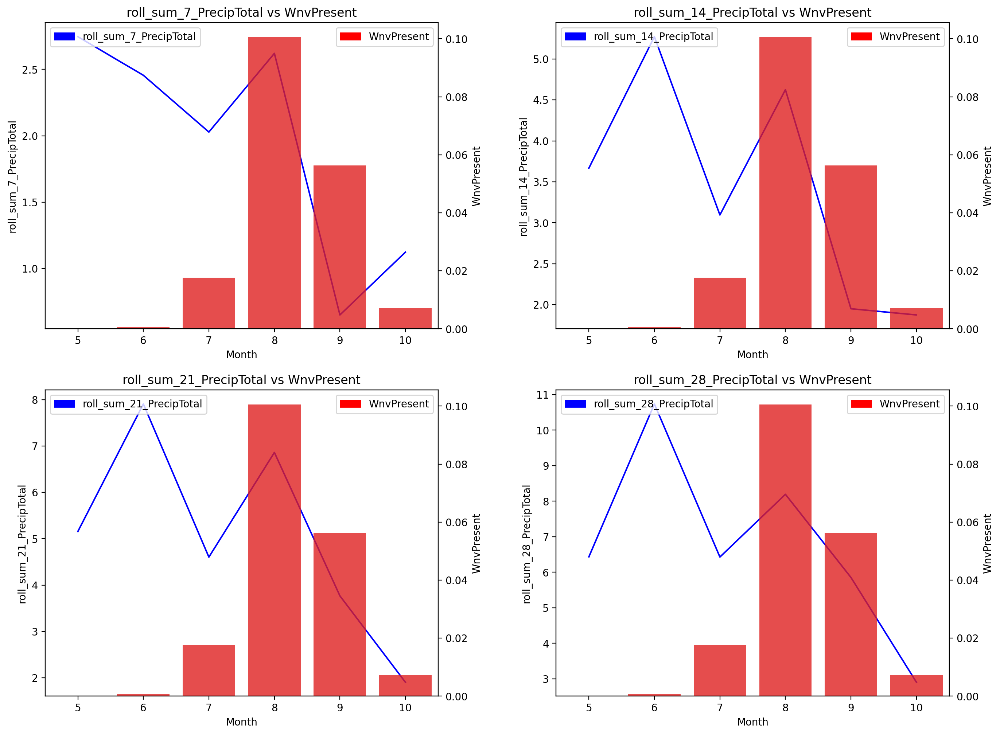

In [61]:
fig, axes = plt.subplots(2,2,figsize=(16,12))
plt.subplots_adjust(wspace=0.3)
axes = axes.flatten()

variables = ['roll_sum_7_PrecipTotal', 'roll_sum_14_PrecipTotal',
       'roll_sum_21_PrecipTotal', 'roll_sum_28_PrecipTotal']

for index, variable in enumerate(variables):
    variable_WnvP_df = grp_df[['Month',variable,'WnvPresent']].groupby('Month').mean()
    variable_WnvP_df = variable_WnvP_df.reset_index(col_level=1)
    variable_WnvP_df = variable_WnvP_df.astype({'Month': 'string'})
    
    sns.lineplot(data=variable_WnvP_df,x='Month',y=variable,ax=axes[index],
             color='blue',sort=False).set(ylabel=variable,title=str(variable) + ' vs WnvPresent')
    ax1_patch = mpatches.Patch(color='blue', label=variable)
    axes[index].legend(handles=[ax1_patch], loc="upper left")
    
    ax2 = axes[index].twinx()
    sns.barplot(data=variable_WnvP_df,x='Month',y='WnvPresent',color='red',ax=ax2, 
            alpha=0.8).set(ylabel='WnvPresent')
    
    ax2.grid(False)
    ax2_patch = mpatches.Patch(color='red', label='WnvPresent')
    ax2.legend(handles=[ax2_patch], loc="upper right")

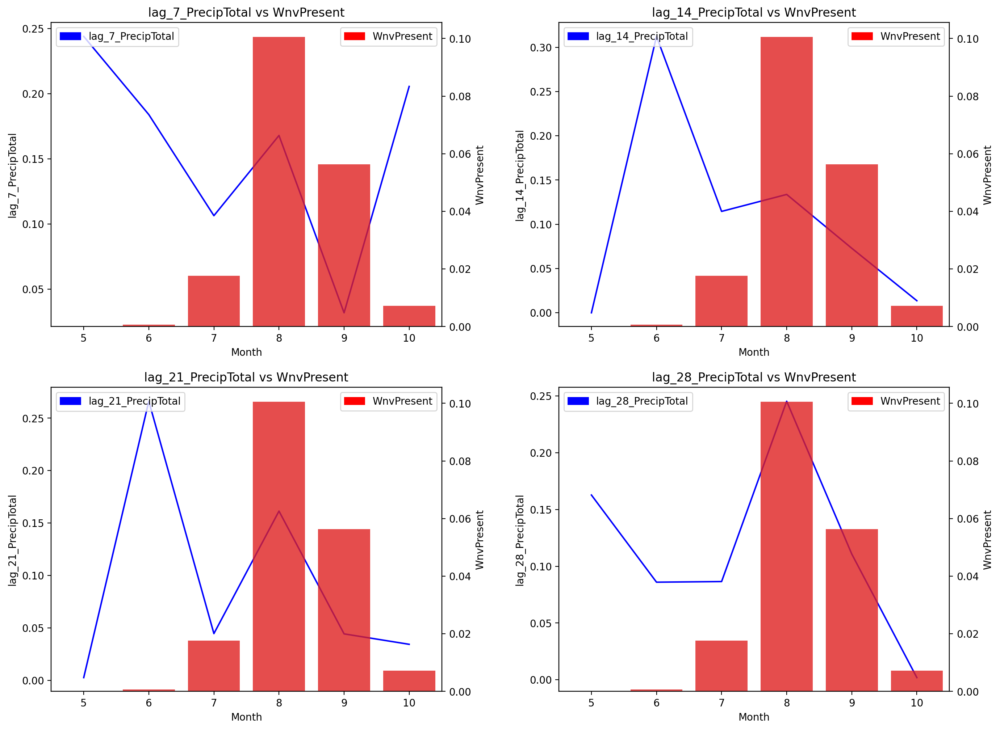

In [62]:
fig, axes = plt.subplots(2,2,figsize=(16,12))
plt.subplots_adjust(wspace=0.3)
axes = axes.flatten()

variables = ['lag_7_PrecipTotal', 'lag_14_PrecipTotal', 'lag_21_PrecipTotal',
       'lag_28_PrecipTotal']

for index, variable in enumerate(variables):
    variable_WnvP_df = grp_df[['Month',variable,'WnvPresent']].groupby('Month').mean()
    variable_WnvP_df = variable_WnvP_df.reset_index(col_level=1)
    variable_WnvP_df = variable_WnvP_df.astype({'Month': 'string'})
    
    sns.lineplot(data=variable_WnvP_df,x='Month',y=variable,ax=axes[index],
             color='blue',sort=False).set(ylabel=variable,title=str(variable) + ' vs WnvPresent')
    ax1_patch = mpatches.Patch(color='blue', label=variable)
    axes[index].legend(handles=[ax1_patch], loc="upper left")
    
    ax2 = axes[index].twinx()
    sns.barplot(data=variable_WnvP_df,x='Month',y='WnvPresent',color='red',ax=ax2, 
            alpha=0.8).set(ylabel='WnvPresent')
    
    ax2.grid(False)
    ax2_patch = mpatches.Patch(color='red', label='WnvPresent')
    ax2.legend(handles=[ax2_patch], loc="upper right")

A correlation is observed between `PrecipTotal` and `WnvPresent`, albeit with a lag evident in `WnvPresent`. We also observe Consequently, it is crucial to keep the new variables encompassing lagged `PrecipTotal` to enhance the predictive capabilities for `WnvPresent`. 

#### Relationship between `SnowFall` and `WnvPresent`

<Axes: xlabel='SnowFall', ylabel='WnvPresent'>

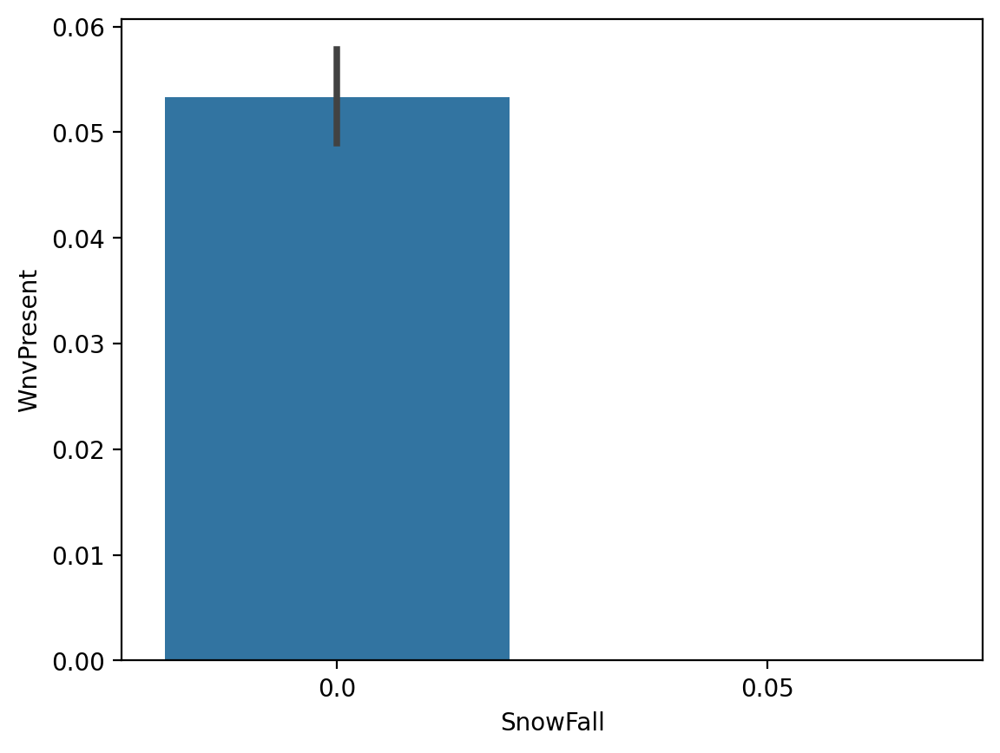

In [63]:
# Snowfall
sns.barplot(data=grp_df, x='SnowFall', y='WnvPresent')

No `WnvPresent` observed when there is `SnowFall`. As such, we are likely to drop this variable.

#### Relationship between `CodeSum` and `WnvPresent`

The Codesum column contains specific codes representing the weather conditions for each day.

<Axes: xlabel='WnvPresent', ylabel='CodeSum'>

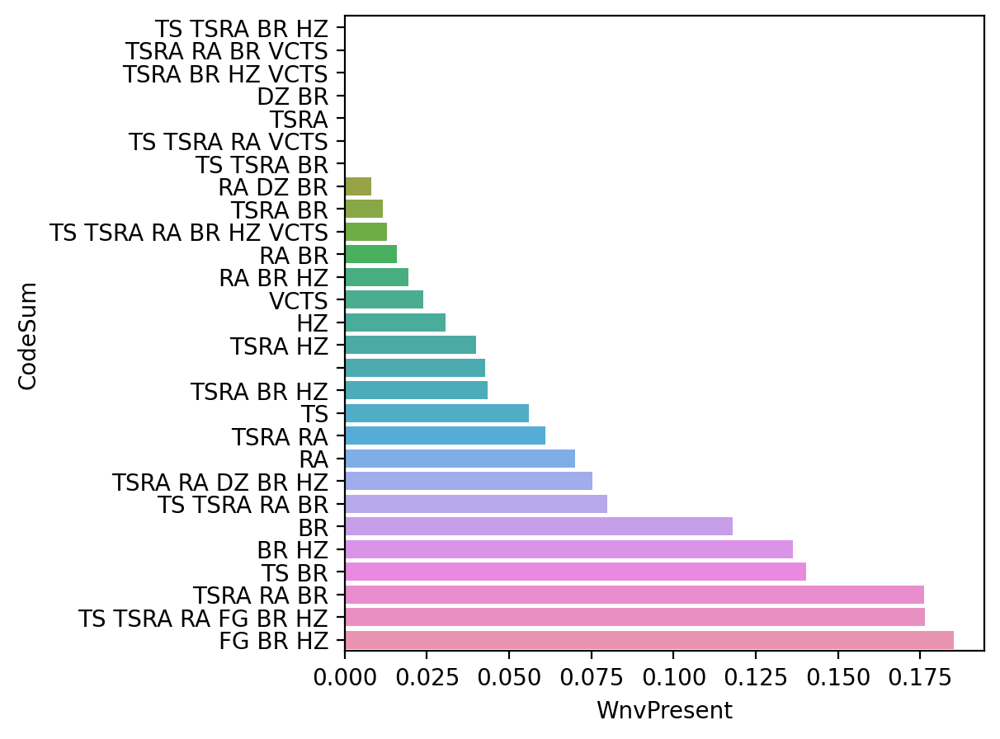

In [64]:
plt.figure(figsize=(5, 5))
codesum = grp_df.groupby('CodeSum')['WnvPresent'].mean().to_frame().sort_values('WnvPresent')
sns.barplot(data=codesum, x='WnvPresent', y=codesum.index)

There seems to be a relationship between the `WnvPresent` and different `CodeSum` categories. Recognizing that distinct weather conditions can potentially impact the presence of West Nile virus and the mosquito population, we will convert the Codesum categories into ordinal representations for further analysis and modeling.

#### Relationship between `Sunrise`, `Sunset` and `WnvPresent`

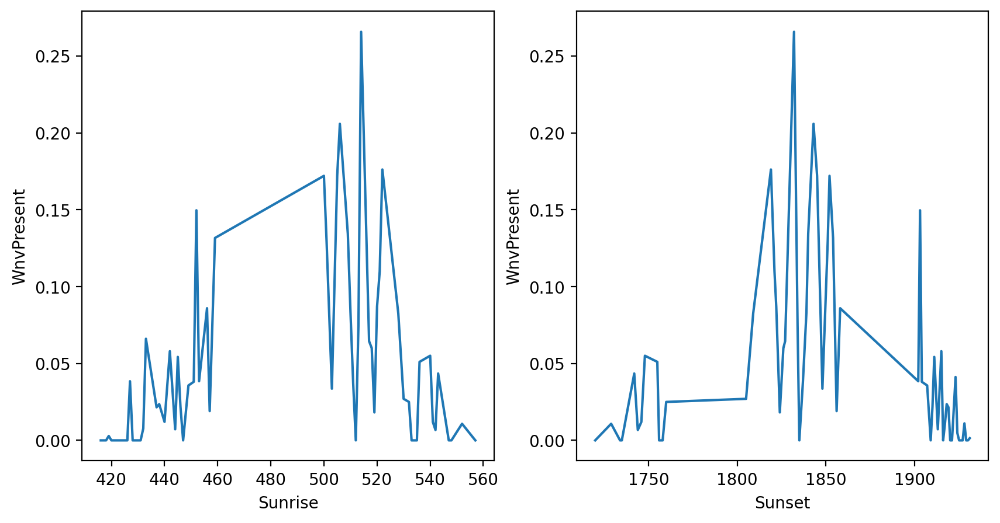

In [65]:
# Correlation of temperatures with number of mosquitoes / wnv
variables = ['Sunrise', 'Sunset']

plt.figure(figsize=(10,5))
for i, col in enumerate(variables):
    ax = plt.subplot(1, 2, i+1)
    sns.lineplot(data=grp_df, x=col, y='WnvPresent', errorbar=None)

A mildly discernible negative parabolic trend can be observed in the relationship between `Sunrise` and `WnvPresent` as well as `Sunset` and `WnvPresent`. However, we are not sure why this is the case. We shall consider feature engineering to learn more about the pattern observed. 

#### Relationship between `ResultSpeed`, `AvgSpeed`, `ResultDir` and `WnvPresent`

Text(0.5, 1.0, 'Resultant Wind Speed and Number of Mosquitos')

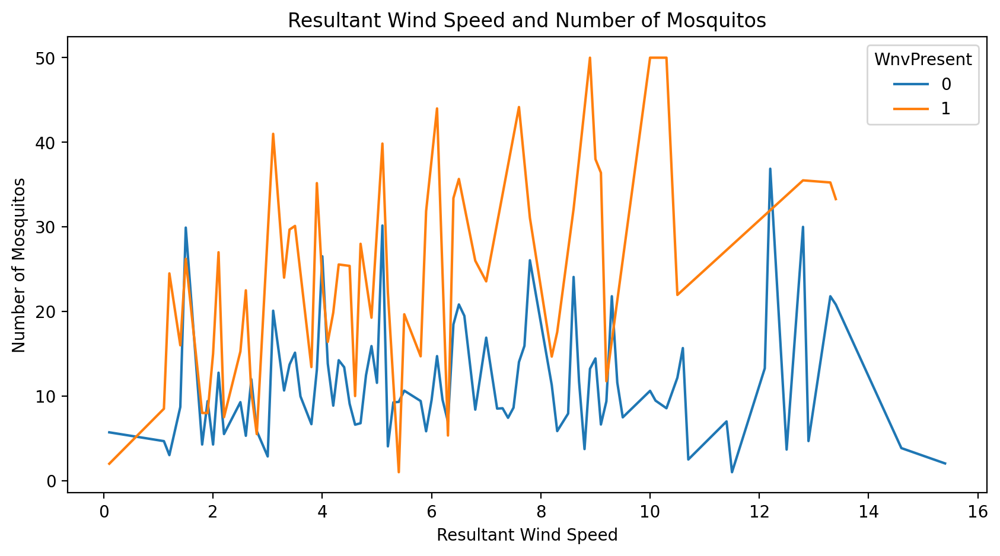

In [66]:
plt.figure(figsize=(10,5))
sns.lineplot(data=grp_df, x='ResultSpeed', y='NumMosquitos', errorbar=None, hue='WnvPresent')
plt.xlabel('Resultant Wind Speed')
plt.ylabel('Number of Mosquitos')
plt.title('Resultant Wind Speed and Number of Mosquitos')

Text(0.5, 1.0, 'Average Wind Speed and Number of Mosquitos')

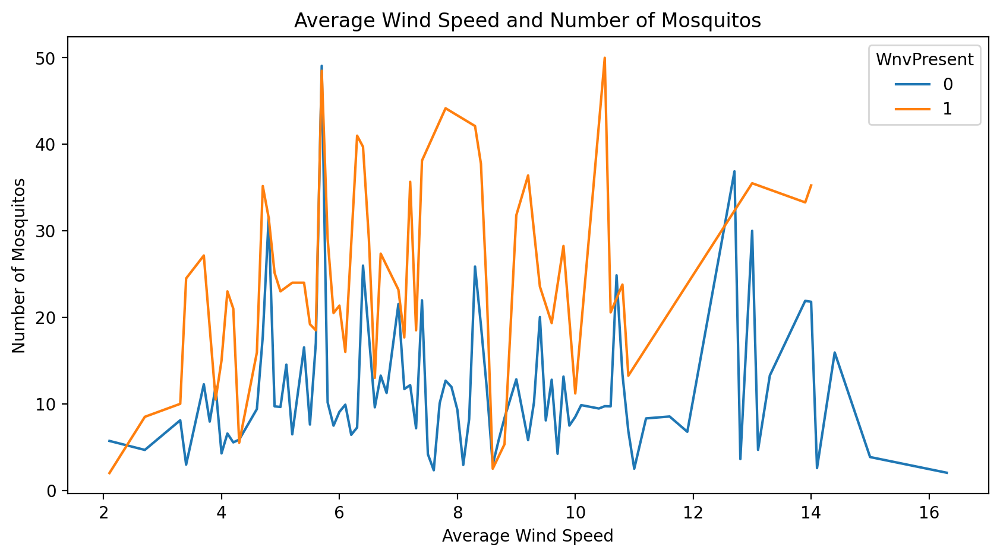

In [67]:
plt.figure(figsize=(10,5))
sns.lineplot(data=grp_df, x='AvgSpeed', y='NumMosquitos', errorbar=None, hue='WnvPresent')
plt.xlabel('Average Wind Speed')
plt.ylabel('Number of Mosquitos')
plt.title('Average Wind Speed and Number of Mosquitos')

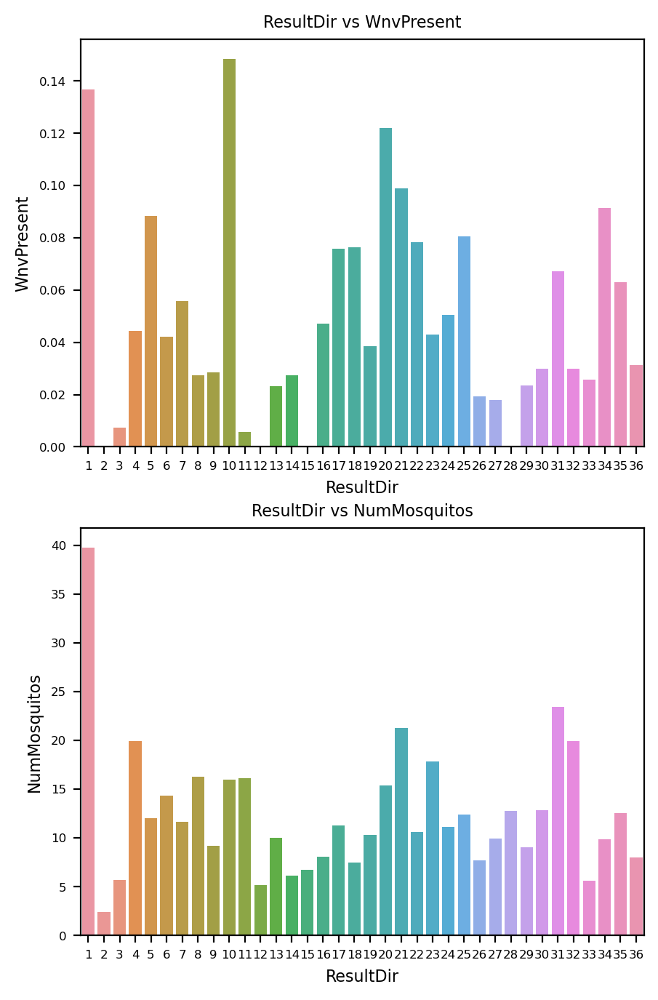

In [68]:
# 'ResultDir' 
variable = 'ResultDir'
variable_WnvP_df = grp_df[[variable,'WnvPresent']].groupby(variable).mean()
variable_WnvP_df = variable_WnvP_df.reset_index(col_level=1)

variable_NumM_df = grp_df[[variable,'NumMosquitos']].groupby(variable).mean()
variable_NumM_df = variable_NumM_df.reset_index(col_level=1)

fig, axes = plt.subplots(2,1,figsize=(5,8))
sns.barplot(data=variable_WnvP_df,y='WnvPresent',x=variable,orient='v', ax=axes[0])
sns.barplot(data=variable_NumM_df,y='NumMosquitos',x=variable,orient='v', ax=axes[1])

fontsize=8
labelsize=6
axes[0].set_title(str(variable) + ' vs WnvPresent', fontsize=fontsize)
axes[0].set_ylabel('WnvPresent',fontsize=fontsize)
axes[0].set_xlabel(variable,fontsize=fontsize)
axes[0].tick_params(labelsize=labelsize)

axes[1].set_title(str(variable) + ' vs NumMosquitos', fontsize=fontsize)
axes[1].set_ylabel('NumMosquitos',fontsize=fontsize)
axes[1].set_xlabel(variable,fontsize=fontsize)
axes[1].tick_params(labelsize=labelsize)

While no distinct correlation can be discerned between wind speed, resultant direction, and the number of mosquitoes, an observation of note is that the upper range of wind speed when `WnvPresent` is present exceeds 10 miles per hour. This observation is likely due to mosquitoes being hindered in their flight and ability to locate potential hosts when exposed to high wind speeds.

#### Relationship between sprays and `WnvPresent`

In [69]:
# save Date as datetime format
spray_df["Date"] = pd.to_datetime(spray_df["Date"])
#create month, week and year columns 
spray_df['Month'] = spray_df['Date'].dt.month
spray_df['Week'] = spray_df['Date'].dt.isocalendar().week
spray_df['Year'] = spray_df['Date'].dt.year
spray_df['Year-Month'] = spray_df['Date'].dt.strftime('%Y %m')

In [70]:
spray_weeks = spray_df.set_index('Week')
spray_weeks = spray_weeks.drop(['Date','Time','Latitude','Longitude','Month','Year-Month'], axis=1)

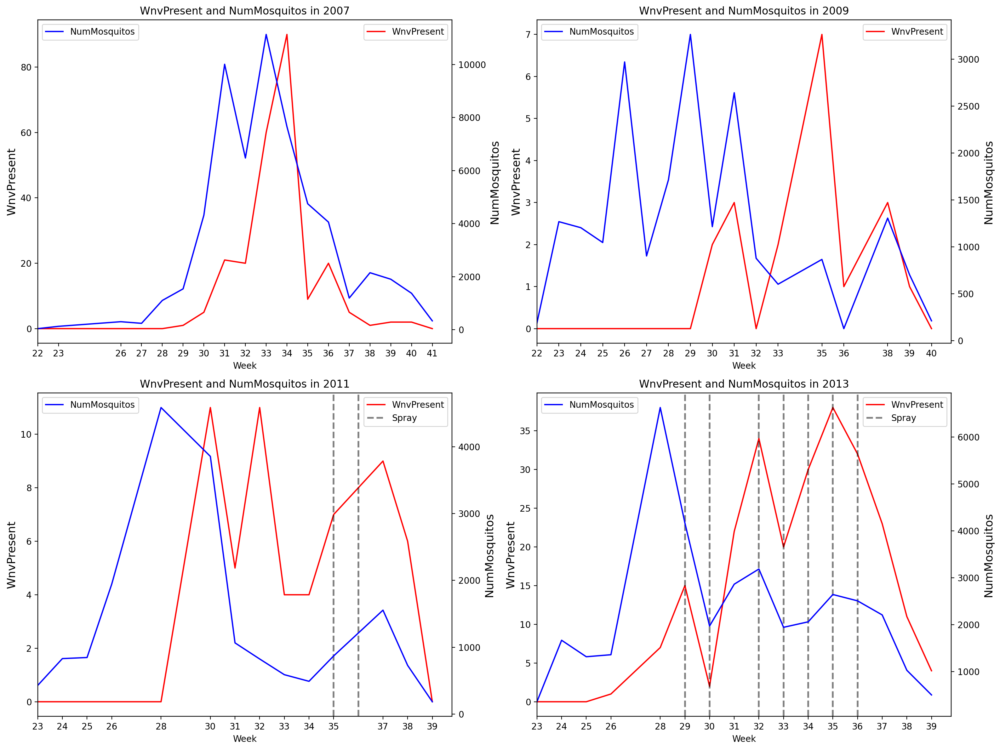

In [71]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(16, 12))
plt.subplots_adjust(top=0.9)  
axes = axes.flatten()

for i, year in enumerate(years):
    ax = axes[i]
    wnv_yearly = grp_df[grp_df['Year'] == year].groupby(['Week'])['WnvPresent'].sum().to_frame()
    num_mosquitoes_yearly = grp_df[grp_df['Year'] == year].groupby('Week')['NumMosquitos'].sum().to_frame()
    wnv_yearly.index = wnv_yearly.index.astype(int)  
    wnv_yearly['WnvPresent'] = pd.to_numeric(wnv_yearly['WnvPresent'], errors='coerce')
    num_mosquitoes_yearly.index = num_mosquitoes_yearly.index.astype(int)  

    sns.lineplot(x=wnv_yearly.index, y=wnv_yearly['WnvPresent'], errorbar=None, color='red', label='WnvPresent', ax=ax)
    ax.set_ylabel('WnvPresent', fontsize=13)
    ax.legend(loc=1)

    ax2 = ax.twinx()  # Create a secondary y-axis
    ax2.plot(num_mosquitoes_yearly.index, num_mosquitoes_yearly['NumMosquitos'], color='blue', label='NumMosquitos')
    ax2.set_ylabel('NumMosquitos', fontsize=13)
    ax2.legend(loc=2)

    if year in spray_weeks['Year'].unique():
        for date in spray_weeks[spray_weeks['Year'] == year].groupby('Week').mean().index:
            ax.axvline(date, linestyle='--', color='black', alpha=0.5, linewidth=2, label='Spray')

    ax.legend(['WnvPresent', 'Spray'])
    ax.set_title(f'WnvPresent and NumMosquitos in {year}')
    ax.set_xlim(26, None)  # Set lower x-axis limit to 26

    # Set x-axis tick positions and labels
    weeks = wnv_yearly.index
    ax.set_xticks(weeks)
    ax.set_xticklabels(weeks)

    # Set x-axis tick positions and labels for the secondary y-axis
    ax2.set_xticks(weeks)
    ax2.set_xticklabels(weeks)

plt.tight_layout()
plt.show()

In the year 2011, two instances of spraying occurred during week 35 and week 36. However, based on the visualizations provided, it can be observed that these spraying activities did not appear to effectively reduce the occurrences of `WnvPresent` or mitigate the population of `NumMosquitos`.

During the year 2013, a total of seven spraying events took place. Notably, the sprays conducted in week 29 and week 32 exhibited a discernible effect in reducing both `WnvPresent` and `NumMosquitos`. However, the sprays administered during week 30, week 33, and week 34 did not yield a noticeable decline in these variables. In line with historical trends, it would be reasonable to anticipate a smaller peak in occurrences during week 35. Surprisingly, despite the repeated spray treatments in preceding weeks, a higher spike is observed instead.

This phenomenon might be attributed to the influence of various additional factors, notably, weather conditions. Elements such as wind speed, temperature, precipitation, and humidity have the potential to impact not only the mosquito population but also the longevity of the airborne presence of the insecticide used in spraying activities. 

We also wish to highlight that the city initiates spraying activities when WNV is consistently detected in mosquito traps over a consecutive two-week period (Thornton, 2021). By then, the mosquito population is likely to have grown, making it harder to curb the spread of West Nile virus. 

<a id='2nd_Feature_Engineering'></a>

### D. 2nd Round of Feature Engineering

#### Check unique categories of `Trap`, `Depart`, and `CodeSum`

In [72]:
check=['Trap','Depart','CodeSum']
for i in check:
    print(grp_df[i].unique())
for i in check:
    print(grp_test_df[i].unique())    

['T002' 'T007' 'T015' 'T143' 'T148' 'T045' 'T046' 'T048' 'T049' 'T050'
 'T054' 'T086' 'T091' 'T094' 'T096' 'T129' 'T153' 'T159' 'T009' 'T011'
 'T016' 'T025' 'T028' 'T141' 'T142' 'T146' 'T149' 'T150' 'T151' 'T218'
 'T220' 'T019' 'T031' 'T033' 'T089' 'T090' 'T092' 'T135' 'T145' 'T147'
 'T152' 'T154' 'T158' 'T162' 'T001' 'T003' 'T006' 'T008' 'T012' 'T037'
 'T034' 'T040' 'T043' 'T047' 'T051' 'T085' 'T088' 'T161' 'T219' 'T013'
 'T014' 'T018' 'T144' 'T030' 'T084' 'T160' 'T005' 'T017' 'T044' 'T095'
 'T004' 'T035' 'T036' 'T039' 'T060' 'T061' 'T062' 'T065' 'T066' 'T067'
 'T069' 'T070' 'T071' 'T073' 'T074' 'T075' 'T076' 'T077' 'T079' 'T080'
 'T081' 'T082' 'T083' 'T114' 'T155' 'T063' 'T115' 'T138' 'T200' 'T206'
 'T209' 'T212' 'T215' 'T107' 'T128' 'T072' 'T027' 'T078' 'T097' 'T099'
 'T100' 'T102' 'T103' 'T156' 'T157' 'T221' 'T900' 'T903' 'T223' 'T222'
 'T225' 'T227' 'T224' 'T226' 'T229' 'T230' 'T228' 'T232' 'T231' 'T235'
 'T233' 'T236' 'T237' 'T238' 'T094B' 'T054C']
[ 10  -9  -8  -6  -3   3  -1   

#### Count the number of traps for each `Date` and `Trap`

As mentioned earlier, since mosquito count records exceeding 50 are split into separate entries, we are able to approximate the number of mosquitos caught by counting the number of entries per day per trap. Thus, we will create a new variable that provides this information.

In [73]:
grp_num_trap_row = grp_df['Trap'].groupby(grp_df['Date']).value_counts()
num_trap_row_df = pd.DataFrame(grp_num_trap_row)
num_trap_row_df = num_trap_row_df.rename(columns = {'Trap': 'num_trap'})
num_trap_row_df = num_trap_row_df.reset_index(col_level=1)
num_trap_row_df

test_grp_num_trap_row = grp_test_df['Trap'].groupby(grp_test_df['Date']).value_counts()
test_num_trap_row_df = pd.DataFrame(test_grp_num_trap_row)
test_num_trap_row_df = test_num_trap_row_df.rename(columns = {'Trap': 'num_trap'})
test_num_trap_row_df = test_num_trap_row_df.reset_index(col_level=1)
test_num_trap_row_df

,Date,Trap,num_trap
0,2008-06-11,T009,16
1,2008-06-11,T035,16
2,2008-06-11,T001,8
3,2008-06-11,T002,8
4,2008-06-11,T002A,8
...,...,...,...
14150,2014-10-02,T236,8
14151,2014-10-02,T237,8
14152,2014-10-02,T238,8
14153,2014-10-02,T900,8


In [74]:
# add new col for number of traps for the specific day (and specific trap)
grp_df = grp_df.merge(num_trap_row_df, how='left',on=['Date','Trap'])
display(grp_df.head())

grp_test_df = grp_test_df.merge(test_num_trap_row_df, how='left',on=['Date','Trap'])
display(grp_test_df.head())

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent,Latitude_rad,Longitude_rad,nearest_weather_station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Day,Month,Year,Week,Year-Month,roll_sum_7_PrecipTotal,roll_sum_14_PrecipTotal,roll_sum_21_PrecipTotal,roll_sum_28_PrecipTotal,lag_7_PrecipTotal,lag_14_PrecipTotal,lag_21_PrecipTotal,lag_28_PrecipTotal,roll_mean_7_Tmax,roll_mean_14_Tmax,roll_mean_21_Tmax,roll_mean_28_Tmax,roll_mean_7_Tmin,roll_mean_14_Tmin,roll_mean_21_Tmin,roll_mean_28_Tmin,roll_mean_7_Tavg,roll_mean_14_Tavg,roll_mean_21_Tavg,roll_mean_28_Tavg,num_trap
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0,0.732951,-1.531863,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,1
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0,0.732586,-1.532832,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0,0.732586,-1.532832,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2


,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,Latitude_rad,Longitude_rad,nearest_weather_station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Day,Month,Year,Week,Year-Month,roll_sum_7_PrecipTotal,roll_sum_14_PrecipTotal,roll_sum_21_PrecipTotal,roll_sum_28_PrecipTotal,lag_7_PrecipTotal,lag_14_PrecipTotal,lag_21_PrecipTotal,lag_28_PrecipTotal,roll_mean_7_Tmax,roll_mean_14_Tmax,roll_mean_21_Tmax,roll_mean_28_Tmax,roll_mean_7_Tmin,roll_mean_14_Tmin,roll_mean_21_Tmin,roll_mean_28_Tmin,roll_mean_7_Tavg,roll_mean_14_Tavg,roll_mean_21_Tavg,roll_mean_28_Tavg,num_trap
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8


#### Create rolling col for `num_trap`

Since mosquito population is likely to be affected by preceeding days' values, we shall create rolling sum `num_trap` to encapsulate this information. 

In [75]:
# to use rolling, set index at 'Date'
grp_df = grp_df.set_index('Date')
# ensure data is sorted by 'Date'
grp_df = grp_df.sort_index()

# to use rolling, set 'Date' as index
grp_test_df = grp_test_df.set_index('Date')
# ensure data is sorted by date
grp_test_df = grp_test_df.sort_index()

In [76]:
# create rolling sum  (14,21,28 days) for 'num_trap'
grp_df['roll_sum_7_num_trap'] = grp_df['num_trap'].rolling('7D').sum()
grp_df['roll_sum_14_num_trap'] = grp_df['num_trap'].rolling('14D').sum()
grp_df['roll_sum_21_num_trap'] = grp_df['num_trap'].rolling('21D').sum()
grp_df['roll_sum_28_num_trap'] = grp_df['num_trap'].rolling('28D').sum()

# create rolling sum  (14,21,28 days) for 'num_trap'
grp_test_df['roll_sum_7_num_trap'] = grp_test_df['num_trap'].rolling('7D').sum()
grp_test_df['roll_sum_14_num_trap'] = grp_test_df['num_trap'].rolling('14D').sum()
grp_test_df['roll_sum_21_num_trap'] = grp_test_df['num_trap'].rolling('21D').sum()
grp_test_df['roll_sum_28_num_trap'] = grp_test_df['num_trap'].rolling('28D').sum()

In [77]:
grp_df = grp_df.reset_index()
display(grp_df.head())

grp_test_df = grp_test_df.reset_index()
display(grp_test_df.head())

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent,Latitude_rad,Longitude_rad,nearest_weather_station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Day,Month,Year,Week,Year-Month,roll_sum_7_PrecipTotal,roll_sum_14_PrecipTotal,roll_sum_21_PrecipTotal,roll_sum_28_PrecipTotal,lag_7_PrecipTotal,lag_14_PrecipTotal,lag_21_PrecipTotal,lag_28_PrecipTotal,roll_mean_7_Tmax,roll_mean_14_Tmax,roll_mean_21_Tmax,roll_mean_28_Tmax,roll_mean_7_Tmin,roll_mean_14_Tmin,roll_mean_21_Tmin,roll_mean_28_Tmin,roll_mean_7_Tavg,roll_mean_14_Tavg,roll_mean_21_Tavg,roll_mean_28_Tavg,num_trap,roll_sum_7_num_trap,roll_sum_14_num_trap,roll_sum_21_num_trap,roll_sum_28_num_trap
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2,2.0,2.0,2.0,2.0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0,0.732247,-1.532416,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2,4.0,4.0,4.0,4.0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0,0.732951,-1.531863,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,1,5.0,5.0,5.0,5.0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0,0.732586,-1.532832,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2,7.0,7.0,7.0,7.0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0,0.732586,-1.532832,1,88,60,74,10,58,65,0,9,421,1917,BR HZ,0,M,0.0,0.0,29.39,30.11,5.8,18,6.5,29,5,2007,22,2007-05,1.535,1.925,3.055,3.08,0.09,0.0,0.0,0.38,78.307692,75.666667,75.97561,74.690909,57.461538,52.296296,52.536585,51.854545,68.076923,64.222222,64.463415,63.363636,2,9.0,9.0,9.0,9.0


,Date,Id,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,Latitude_rad,Longitude_rad,nearest_weather_station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Day,Month,Year,Week,Year-Month,roll_sum_7_PrecipTotal,roll_sum_14_PrecipTotal,roll_sum_21_PrecipTotal,roll_sum_28_PrecipTotal,lag_7_PrecipTotal,lag_14_PrecipTotal,lag_21_PrecipTotal,lag_28_PrecipTotal,roll_mean_7_Tmax,roll_mean_14_Tmax,roll_mean_21_Tmax,roll_mean_28_Tmax,roll_mean_7_Tmin,roll_mean_14_Tmin,roll_mean_21_Tmin,roll_mean_28_Tmin,roll_mean_7_Tavg,roll_mean_14_Tavg,roll_mean_21_Tavg,roll_mean_28_Tavg,num_trap,roll_sum_7_num_trap,roll_sum_14_num_trap,roll_sum_21_num_trap,roll_sum_28_num_trap
0,2008-06-11,1,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8,8.0,8.0,8.0,8.0
1,2008-06-11,2,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8,16.0,16.0,16.0,16.0
2,2008-06-11,3,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8,24.0,24.0,24.0,24.0
3,2008-06-11,4,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8,32.0,32.0,32.0,32.0
4,2008-06-11,5,"4100 North Oak Park Avenue, Chicago, IL 60634, USA",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9,0.732247,-1.532416,1,86,61,74,7,56,64,0,9,416,1926,,0,M,0.0,0.0,29.28,29.99,8.9,18,10.0,11,6,2008,24,2008 06,3.99,6.25,6.74,7.135,0.07,0.005,0.0,0.0,83.230769,79.407407,74.560976,71.854545,65.692308,60.148148,55.219512,52.472727,74.692308,70.037037,65.146341,62.436364,8,40.0,40.0,40.0,40.0


In [78]:
display(grp_df.isnull().sum())
display(grp_test_df.isnull().sum())

Date                       0
Address                    0
Species                    0
Block                      0
Street                     0
Trap                       0
AddressNumberAndStreet     0
Latitude                   0
Longitude                  0
AddressAccuracy            0
NumMosquitos               0
WnvPresent                 0
Latitude_rad               0
Longitude_rad              0
nearest_weather_station    0
Tmax                       0
Tmin                       0
Tavg                       0
Depart                     0
DewPoint                   0
WetBulb                    0
Heat                       0
Cool                       0
Sunrise                    0
Sunset                     0
CodeSum                    0
Depth                      0
Water1                     0
SnowFall                   0
PrecipTotal                0
StnPressure                0
SeaLevel                   0
ResultSpeed                0
ResultDir                  0
AvgSpeed      

Date                       0
Id                         0
Address                    0
Species                    0
Block                      0
Street                     0
Trap                       0
AddressNumberAndStreet     0
Latitude                   0
Longitude                  0
AddressAccuracy            0
Latitude_rad               0
Longitude_rad              0
nearest_weather_station    0
Tmax                       0
Tmin                       0
Tavg                       0
Depart                     0
DewPoint                   0
WetBulb                    0
Heat                       0
Cool                       0
Sunrise                    0
Sunset                     0
CodeSum                    0
Depth                      0
Water1                     0
SnowFall                   0
PrecipTotal                0
StnPressure                0
SeaLevel                   0
ResultSpeed                0
ResultDir                  0
AvgSpeed                   0
Day           

#### Map ordinal values to categories

As previously indicated, certain variables are expected to enhance prediction accuracy after converting each unique category into an ordinal representation. Consequently, we will proceed with the appropriate conversion of these categories accordingly.

In [79]:
# convert categories to numbers
def convert(df,col_to_convert,y):
    # group different col_to_convert together
    convert_df = df[[col_to_convert,y]].groupby(col_to_convert).sum()
    convert_df = pd.DataFrame(convert_df)
    convert_df = convert_df.reset_index(col_level=1)
    
    count_df = df[[col_to_convert,y]].groupby([col_to_convert]).count()
    count_df = count_df.reset_index(col_level=1)
    count_df.rename(columns={y: 'count'}, inplace=True)
    
    convert_df['count'] = count_df['count']

    # create new col with ratio of WnvPresent / total WnvPresent
    convert_df['ratio'] = convert_df[y] / convert_df['count']
    # create dictionary
    convert_dict = dict(zip(convert_df[col_to_convert],convert_df['ratio']))
    # using newly created dict to change col_to_convert values
    df[col_to_convert] = df[col_to_convert].map(convert_dict)
    return df[col_to_convert]

In [80]:
# convert classes to numbers
def convert_test(df,test_df,col_to_convert,y):
    # group different col_to_convert together
    convert_df = df[[col_to_convert,y]].groupby(col_to_convert).sum()
    convert_df = pd.DataFrame(convert_df)
    convert_df = convert_df.reset_index(col_level=1)
    
    count_df = df[[col_to_convert,y]].groupby([col_to_convert]).count()
    count_df = count_df.reset_index(col_level=1)
    count_df.rename(columns={y: 'count'}, inplace=True)
    
    convert_df['count'] = count_df['count']

    # create new col with ratio of WnvPresent / total WnvPresent
    convert_df['ratio'] = convert_df[y] / convert_df['count']
    
    # create dictionary
    convert_dict = dict(zip(convert_df[col_to_convert],convert_df['ratio']))
    # using newly created dict to change col_to_convert values
    test_df[col_to_convert] = test_df[col_to_convert].map(convert_dict)
    return test_df[col_to_convert].unique()

#### Convert `Species` to ordinal representation

In [81]:
# convert 'Species'
convert(grp_df,'Species','WnvPresent')

0        0.055135
1        0.017883
2        0.017883
3        0.055135
4        0.017883
           ...   
10501    0.055135
10502    0.088922
10503    0.055135
10504    0.055135
10505    0.055135
Name: Species, Length: 10506, dtype: float64

In [82]:
# convert 'Species'
convert_test(final_train_df,grp_test_df,'Species','WnvPresent')

array([0.05513468, 0.01788321, 0.08892182, 0.        ,        nan])

In [83]:
grp_test_df['Species'] = grp_test_df['Species'].fillna(0)
grp_test_df['Species'].unique()

array([0.05513468, 0.01788321, 0.08892182, 0.        ])

#### Create new variable that uses `Species` and `roll_sum_28_num_trap`

In [84]:
grp_df['speciesXroll_sum_28_num_trap'] = grp_df['Species'] * grp_df['roll_sum_28_num_trap']

grp_test_df['speciesXroll_sum_28_num_trap'] = grp_test_df['Species'] * grp_test_df['roll_sum_28_num_trap']

#### Convert `Latitude` and `Longitude` to ordinal representation

Split data into clusters

In [85]:
def optimise_k_means(data, max_k):
    means = []
    inertias = []
    
    for k in range(1,max_k):
        kmeans = KMeans(n_clusters=k,n_init=20) # n_init = Number of times the k-means algorithm is run with different centroid seeds.
        kmeans.fit(data)
        means.append(k)
        inertias.append(kmeans.inertia_)
        
    fig = plt.subplots(figsize=(10, 5))
    plt.plot(means, inertias, 'o-')
    plt.xlabel("Number of Clusters")
    plt.ylabel("Inertia")
    plt.grid(True)
    plt.show()

In [86]:
lst_cluster = ['Latitude', 'Longitude']
# to use elbow method to get optimal n_cluster: 
# optimise_k_means(grp_df[lst_cluster], 50)

In [87]:
n_clusters=50

In [88]:
# Create the KMeans model with the selected number of clusters, train data
kmeans = KMeans(n_clusters=n_clusters,n_init=20,random_state=42)

# Fit the model 
kmeans.fit(grp_df[lst_cluster])

# save labels in grp_df
grp_df['KMeans'] = kmeans.labels_
final_train_df['KMeans'] = grp_df['KMeans']

In [89]:
# Create the KMeans model with the selected number of clusters, test data
kmeans = KMeans(n_clusters=n_clusters,n_init=20,random_state=42)

# Fit the model 
kmeans.fit(grp_test_df[lst_cluster])

# save labels in grp_df
grp_test_df['KMeans'] = kmeans.labels_

In [90]:
# convert 'KMeans' to object so that it becomes a categorical variable
grp_df = grp_df.astype({'KMeans':'object'})
grp_df.info()

# convert 'KMeans' to object so that it becomes a categorical variable
grp_test_df = grp_test_df.astype({'KMeans':'object'})
grp_test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10506 entries, 0 to 10505
Data columns (total 67 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   Date                          10506 non-null  datetime64[ns]
 1   Address                       10506 non-null  object        
 2   Species                       10506 non-null  float64       
 3   Block                         10506 non-null  int64         
 4   Street                        10506 non-null  object        
 5   Trap                          10506 non-null  object        
 6   AddressNumberAndStreet        10506 non-null  object        
 7   Latitude                      10506 non-null  float64       
 8   Longitude                     10506 non-null  float64       
 9   AddressAccuracy               10506 non-null  int64         
 10  NumMosquitos                  10506 non-null  int64         
 11  WnvPresent                  

In [91]:
convert(grp_df,'KMeans','NumMosquitos')

0        16.980695
1        16.980695
2        16.000000
3        11.412429
4        11.412429
           ...    
10501     7.422460
10502     7.422460
10503     7.556098
10504     7.494118
10505     6.274194
Name: KMeans, Length: 10506, dtype: float64

In [92]:
convert_test(final_train_df,grp_test_df,'KMeans','WnvPresent')

array([0.05421687, 0.04390244, 0.08270677, 0.00684932, 0.04371585,
       0.10679612, 0.064     , 0.05882353, 0.01363636, 0.04888889,
       0.07363014, 0.11299435, 0.05825243, 0.06081081, 0.03196347,
       0.00775194, 0.00512821, 0.        , 0.13605442, 0.0483871 ,
       0.01219512, 0.04069767, 0.05347594, 0.06875   , 0.02898551,
       0.08974359, 0.07722008, 0.02158273, 0.03488372, 0.08035714,
       0.02242152, 0.05      , 0.07142857, 0.04285714, 0.075     ,
       0.04878049, 0.0660793 , 0.05641026, 0.04433498, 0.05287356,
       0.04395604, 0.03424658, 0.01351351, 0.01204819, 0.03703704,
       0.088     , 0.0464135 , 0.09302326, 0.04014599])

#### Convert `Trap` to ordinal representation

Similar to `Latitude` and `Longitude`, we deem it appropriate to assign an ordinal value to the variable `Trap` in order to enhance its predictive power.

In [93]:
# convert 'Trap'
convert(grp_df,'Trap','WnvPresent')

0        0.097297
1        0.097297
2        0.000000
3        0.114286
4        0.114286
           ...   
10501    0.107692
10502    0.107692
10503    0.041667
10504    0.040000
10505    0.112903
Name: Trap, Length: 10506, dtype: float64

Additional step required for test dataset due to missing values. We shall replace missing trap with nearest trap.

In [94]:
# find 'Trap' that were not present in training
missing_trap = [i for i in final_test_df['Trap'].unique() if i not in final_train_df['Trap'].unique()]
latitude_lst = []
longitude_lst = []
for i in range(len(missing_trap)):
    latitude_lst.append(final_test_df[final_test_df['Trap'] == missing_trap[i]]['Latitude'].mean())
    longitude_lst.append(final_test_df[final_test_df['Trap'] == missing_trap[i]]['Longitude'].mean())

In [95]:
missing_trap_df = pd.DataFrame({'Trap': missing_trap,
                                'Latitude':latitude_lst,
                                'Longitude':longitude_lst})
missing_trap_df

,Trap,Latitude,Longitude
0,T218A,41.954770,-87.730890
1,T218B,41.948280,-87.741340
2,T002A,41.965571,-87.781978
3,T002B,41.951878,-87.789234
4,T234,41.942285,-87.761726
5,T090A,41.690423,-87.656929
6,T090B,41.868533,-87.661638
7,T090C,41.675876,-87.651515
8,T200A,41.731929,-87.548540
9,T128A,41.738583,-87.567726


In [96]:
# create new cols with lat and lon radians
missing_trap_df['Latitude_rad'] = np.deg2rad(missing_trap_df['Latitude'])
missing_trap_df['Longitude_rad'] = np.deg2rad(missing_trap_df['Longitude'])

In [97]:
missing_trap_df

,Trap,Latitude,Longitude,Latitude_rad,Longitude_rad
0,T218A,41.954770,-87.730890,0.732249,-1.531193
1,T218B,41.948280,-87.741340,0.732136,-1.531375
2,T002A,41.965571,-87.781978,0.732437,-1.532085
3,T002B,41.951878,-87.789234,0.732198,-1.532211
4,T234,41.942285,-87.761726,0.732031,-1.531731
5,T090A,41.690423,-87.656929,0.727635,-1.529902
6,T090B,41.868533,-87.661638,0.730744,-1.529984
7,T090C,41.675876,-87.651515,0.727381,-1.529808
8,T200A,41.731929,-87.548540,0.728360,-1.528010
9,T128A,41.738583,-87.567726,0.728476,-1.528345


In [98]:
# Takes the first group's latitude and longitude values to construct
# the ball tree.
ball = BallTree(final_train_df[['Latitude_rad','Longitude_rad']], metric='haversine')
# The amount of neighbors to return.
k = 1
# Executes a query with the second group. This will also return two
# arrays.
distances, indices = ball.query(missing_trap_df[["Latitude_rad", "Longitude_rad"]].values, k = k)

# if wish to convert to kilometers: distance x 6371
nearest_trap = []
for i in indices:
    nearest_trap.append(final_train_df.iloc[i[0],5]) # 'Trap' is on col 5
missing_trap_df['nearest_trap'] = nearest_trap
missing_trap_df.head()

,Trap,Latitude,Longitude,Latitude_rad,Longitude_rad,nearest_trap
0,T218A,41.954770,-87.730890,0.732249,-1.531193,T001
1,T218B,41.948280,-87.741340,0.732136,-1.531375,T001
2,T002A,41.965571,-87.781978,0.732437,-1.532085,T017
3,T002B,41.951878,-87.789234,0.732198,-1.532211,T002
4,T234,41.942285,-87.761726,0.732031,-1.531731,T005


In [99]:
# replace missing trap with nearest trap
for i in range(len(missing_trap)):
    grp_test_df['Trap'] = grp_test_df['Trap'].replace(missing_trap[i],nearest_trap[i])

In [100]:
# convert 'Trap'
convert_test(final_train_df,grp_test_df,'Trap','WnvPresent')

array([0.0972973 , 0.        , 0.11428571, 0.19354839, 0.08108108,
       0.08270677, 0.10606061, 0.07692308, 0.05555556, 0.03846154,
       0.02702703, 0.04081633, 0.1147541 , 0.16666667, 0.07194245,
       0.03809524, 0.03448276, 0.09615385, 0.13333333, 0.14285714,
       0.07526882, 0.088     , 0.07142857, 0.10344828, 0.09677419,
       0.0952381 , 0.14      , 0.03030303, 0.08571429, 0.02739726,
       0.01176471, 0.03680982, 0.09302326, 0.03125   , 0.03305785,
       0.12      , 0.03603604, 0.03424658, 0.05154639, 0.04395604,
       0.04635762, 0.04371585, 0.01098901, 0.02150538, 0.04761905,
       0.02631579, 0.06349206, 0.04      , 0.04166667, 0.05      ,
       0.0776699 , 0.01219512, 0.04587156, 0.05172414, 0.03333333,
       0.01204819, 0.1       , 0.0173913 , 0.02173913, 0.06818182,
       0.08163265, 0.06081081, 0.06976744, 0.01923077, 0.07564576,
       0.05095541, 0.00775194, 0.02307692, 0.01973684, 0.06666667,
       0.09090909, 0.06875   , 0.05882353, 0.01785714, 0.07228

In [101]:
grp_test_df['Trap'] = grp_test_df['Trap'].fillna(0.005)
grp_test_df['Trap'].unique()

array([0.0972973 , 0.        , 0.11428571, 0.19354839, 0.08108108,
       0.08270677, 0.10606061, 0.07692308, 0.05555556, 0.03846154,
       0.02702703, 0.04081633, 0.1147541 , 0.16666667, 0.07194245,
       0.03809524, 0.03448276, 0.09615385, 0.13333333, 0.14285714,
       0.07526882, 0.088     , 0.07142857, 0.10344828, 0.09677419,
       0.0952381 , 0.14      , 0.03030303, 0.08571429, 0.02739726,
       0.01176471, 0.03680982, 0.09302326, 0.03125   , 0.03305785,
       0.12      , 0.03603604, 0.03424658, 0.05154639, 0.04395604,
       0.04635762, 0.04371585, 0.01098901, 0.02150538, 0.04761905,
       0.02631579, 0.06349206, 0.04      , 0.04166667, 0.05      ,
       0.0776699 , 0.01219512, 0.04587156, 0.05172414, 0.03333333,
       0.01204819, 0.1       , 0.0173913 , 0.02173913, 0.06818182,
       0.08163265, 0.06081081, 0.06976744, 0.01923077, 0.07564576,
       0.05095541, 0.00775194, 0.02307692, 0.01973684, 0.06666667,
       0.09090909, 0.06875   , 0.05882353, 0.01785714, 0.07228

#### Convert `CodeSum` to ordinal representation

In [102]:
# convert 'CodeSum'
convert(grp_df,'CodeSum','WnvPresent')

0        0.136187
1        0.136187
2        0.136187
3        0.136187
4        0.136187
           ...   
10501    0.042585
10502    0.042585
10503    0.042585
10504    0.042585
10505    0.042585
Name: CodeSum, Length: 10506, dtype: float64

In [103]:
# convert 'CodeSum'
convert_test(final_train_df,grp_test_df,'CodeSum','WnvPresent')

array([0.04258542, 0.17607973,        nan, 0.06091371, 0.0798005 ,
       0.03076923, 0.13618677, 0.07014925, 0.056     , 0.        ,
       0.01581722, 0.01930502, 0.01149425, 0.11796247, 0.14035088,
       0.008     ])

In [104]:
grp_test_df['CodeSum'] = grp_test_df['CodeSum'].fillna(0.003)
grp_test_df['CodeSum'].unique()

array([0.04258542, 0.17607973, 0.003     , 0.06091371, 0.0798005 ,
       0.03076923, 0.13618677, 0.07014925, 0.056     , 0.        ,
       0.01581722, 0.01930502, 0.01149425, 0.11796247, 0.14035088,
       0.008     ])

#### Create new variables from `Sunset` and `Sunrise`

Given the uncertainty surrounding the negative parabolic relationship between Sunrise and Sunset with respect to WnvPresent, we recognized the necessity to perform feature engineering by deriving new variables from these existing variables. This approach aims to evaluate the predictive potential of the newly engineered features.

In [105]:
# train
grp_df['timetomidnight'] = 24 - grp_df['Sunset'].astype(str).str[:2].astype(int) + grp_df['Sunset'].astype(str).str[2:].astype(int) / 60
grp_df['timefrommidnight'] = grp_df['Sunrise'].astype(str).str[0].astype(int) + grp_df['Sunrise'].astype(str).str[1:].astype(int)/60
grp_df['timediff'] = grp_df['timetomidnight'] + grp_df['timefrommidnight'] # length of night

# test
grp_test_df['timetomidnight'] = 24 - grp_test_df['Sunset'].astype(str).str[:2].astype(int) + grp_test_df['Sunset'].astype(str).str[2:].astype(int) / 60
grp_test_df['timefrommidnight'] = grp_test_df['Sunrise'].astype(str).str[0].astype(int) + grp_test_df['Sunrise'].astype(str).str[1:].astype(int)/60
grp_test_df['timediff'] = grp_test_df['timetomidnight'] + grp_test_df['timefrommidnight']

<a id='export'></a>

## 4. Export

In [106]:
# export this dataframe for use in Part III: Modelling
pd.DataFrame(grp_df).to_csv('../data/input/train_eda_fe.csv', index = False)
pd.DataFrame(grp_test_df).to_csv('../data/input/test_eda_fe.csv', index = False)

<a id='citations'></a>

## 5. Citations

Drakou, K., Nikolaou, T., Vasquez, M. I., Petrić, D., Michaelakis, A., Kapranas, A., Papatheodoulou, A., & Koliou, M. (2020). The Effect of Weather Variables on Mosquito Activity: A Snapshot of the Main Point of Entry of Cyprus. International Journal of Environmental Research and Public Health, 17(4), 1403. Retrieved July 4, 2023, from https://doi.org/10.3390/ijerph17041403

Lebl, K., Brugger, K., & Rubel, F. (2013). Predicting Culex pipiens/restuans population dynamics by interval lagged weather data. Parasites & Vectors, 6(1). Retrieved July 4, 2023, from https://doi.org/10.1186/1756-3305-6-129

Thornton, S. (2021). Chicago Turns to Predictive Analytics to Map West Nile Threat. GovTech. Retrieved July 4, 2023, from https://www.govtech.com/analytics/chicago-turns-to-predictive-analytics-to-map-west-nile-threat.html

What Does It All Mean? (2020, February 24). Retrieved July 4, 2023, from https://www.nrcc.cornell.edu/services/blog/2020/02/24/index.html

## <b> End of Part II</b> <br>
[Part I](Part_1-Cleaning.ipynb#part_i) <br>
[Part III](Part_3-Modelling.ipynb#part_ii)